# Monet Style Transfer using CycleGAN

## Introduction

In this notebook, I'll implement a CycleGAN to transform ordinary photographs into paintings in the style of Claude Monet. This is a style transfer problem, where I want to learn the mapping between two domains: regular photos and Monet paintings.

CycleGAN is particularly suitable for this task because:
1. It doesn't require paired data 
2. It can preserve the content of the original image while transferring the style
3. It learns bidirectional mappings between domains

I'll be using TensorFlow/Keras to implement our solution.

## Project Overview

This project is done as part week 5 assignment of Introduction to Deep Learning course.

## Problem Statement

Given a dataset of Monet paintings and regular photographs, my goal is to:
1. Build a generative model that can transform regular photos to have Monet's painting style
2. Ensure the content and structure of the original photos are preserved
3. Create visually appealing and convincing Monet-style images

## Import Python packages

In [1]:
# Import necessary libraries
import os
import time
import zipfile
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from glob import glob
from tqdm.notebook import tqdm

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.data.experimental import AUTOTUNE

import warnings
warnings.filterwarnings('ignore')

# Set random seeds for reproducibility
SEED = 42
np.random.seed(SEED)
tf.random.set_seed(SEED)

# Check TensorFlow version and GPU availability
print(f"TensorFlow version: {tf.__version__}")
print(f"GPU Available: {len(tf.config.list_physical_devices('GPU')) > 0}")

TensorFlow version: 2.16.2
GPU Available: True


## Data Load

Data have been downloaded from I’m Something of a Painter Myself Kaggle website (https://www.kaggle.com/competitions/gan-getting-started/data) to local and placed in gan-getting-started directory.

In [2]:
os.listdir("./gan-getting-started/")

['.DS_Store', 'photo_jpg', 'monet_jpg', 'photo_tfrec', 'monet_tfrec']

In [3]:
# Define paths
MONET_JPG_PATH = './gan-getting-started/monet_jpg/'
PHOTO_JPG_PATH = './gan-getting-started/photo_jpg/'
MONET_TFREC_PATH = './gan-getting-started/monet_tfrec/'
PHOTO_TFREC_PATH = './gan-getting-started/photo_tfrec/'

# Count images in each directory
monet_jpg_files = tf.io.gfile.glob(os.path.join(MONET_JPG_PATH, '*.jpg'))
photo_jpg_files = tf.io.gfile.glob(os.path.join(PHOTO_JPG_PATH, '*.jpg'))
monet_tfrec_files = tf.io.gfile.glob(os.path.join(MONET_TFREC_PATH, '*.tfrec'))
photo_tfrec_files = tf.io.gfile.glob(os.path.join(PHOTO_TFREC_PATH, '*.tfrec'))

print(f"Number of Monet paintings (JPG): {len(monet_jpg_files)}")
print(f"Number of Photos (JPG): {len(photo_jpg_files)}")
print(f"\nNumber of Monet TFRECs: {len(monet_tfrec_files)}")
print(f"Number of Photos TFRECs: {len(photo_tfrec_files)}")


Number of Monet paintings (JPG): 300
Number of Photos (JPG): 7038

Number of Monet TFRECs: 5
Number of Photos TFRECs: 20


## Data Load

In [4]:
IMAGE_SIZE = [256, 256] # All images are 256x256
BATCH_SIZE_PER_REPLICA = 16 
GLOBAL_BATCH_SIZE = BATCH_SIZE_PER_REPLICA * tf.distribute.get_strategy().num_replicas_in_sync
AUTOTUNE = tf.data.AUTOTUNE

# Decode TFREC Images
def decode_image(image_data):
    image = tf.image.decode_jpeg(image_data, channels=3)
    image = tf.cast(image, tf.float32) / 127.5 - 1 # Normalize to [-1, 1]
    image = tf.reshape(image, [*IMAGE_SIZE, 3])
    return image

# Read TFREC records
def read_tfrecord(example):
    tfrecord_format = {
        "image_name": tf.io.FixedLenFeature([], tf.string),
        "image": tf.io.FixedLenFeature([], tf.string),
        "target": tf.io.FixedLenFeature([], tf.string)
    }
    
    example = tf.io.parse_single_example(example, tfrecord_format)
    image = decode_image(example['image'])
    return image

# Function to Load dataset
def load_dataset(filenames, labeled=True, ordered=False):
    dataset = tf.data.TFRecordDataset(filenames, num_parallel_reads=AUTOTUNE)
    dataset = dataset.map(read_tfrecord, num_parallel_calls=AUTOTUNE)
    #dataset = dataset.shuffle(1024)
    #dataset = dataset.repeat()
    #dataset = dataset.batch(GLOBAL_BATCH_SIZE)
    #dataset = dataset.prefetch(AUTOTUNE)
    return dataset


# Load Monet & Phoro TFREC files
monet_ds = load_dataset(monet_tfrec_files, labeled=True)
photo_ds = load_dataset(photo_tfrec_files, labeled=True)

2025-05-20 14:28:27.127552: I metal_plugin/src/device/metal_device.cc:1154] Metal device set to: Apple M4 Pro
2025-05-20 14:28:27.127575: I metal_plugin/src/device/metal_device.cc:296] systemMemory: 24.00 GB
2025-05-20 14:28:27.127578: I metal_plugin/src/device/metal_device.cc:313] maxCacheSize: 8.00 GB
2025-05-20 14:28:27.127595: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2025-05-20 14:28:27.127602: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


##  Visualize Sample TFREC Images

2025-05-20 14:28:27.242728: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


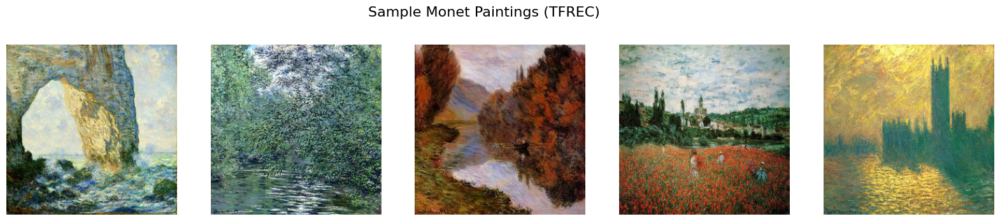

2025-05-20 14:28:27.319031: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


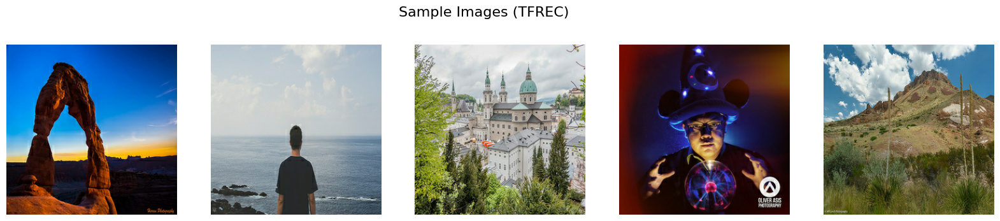

In [5]:
n_samples=5
plt.figure(figsize=(n_samples * 4, 4))
for i, image in enumerate(monet_ds.batch(1).take(n_samples)): # Takes one batch
    plt.subplot(1, n_samples, i + 1)
    plt.imshow(image[0] * 0.5 + 0.5) # Denormalize
    plt.axis('off')
plt.suptitle("Sample Monet Paintings (TFREC)", fontsize=16)
plt.show()

plt.figure(figsize=(n_samples * 4, 4))
for i, image in enumerate(photo_ds.batch(1).take(n_samples)): # Takes one batch
    plt.subplot(1, n_samples, i + 1)
    plt.imshow(image[0].numpy() * 0.5 + 0.5) # Denormalize
    plt.axis('off')
plt.suptitle("Sample Images (TFREC)", fontsize=16)
plt.show()

### Visualize Sample JPG Images

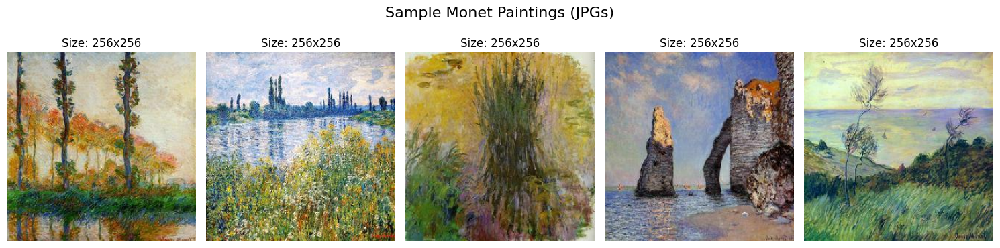

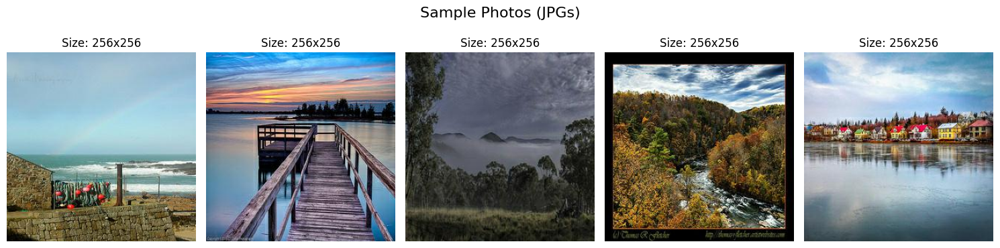

In [6]:
# Sample images from Monet paintings
sample_monet = np.random.choice(monet_jpg_files, size=min(5, len(monet_jpg_files)), replace=False)
fig, axes = plt.subplots(1, 5, figsize=(15,4))
for i, ax in enumerate(axes.flat):
    img = load_img(sample_monet[i])
    ax.imshow(img)
    ax.set_title(f"Size: {img.size[0]}x{img.size[1]}")
    ax.axis('off')
plt.suptitle("Sample Monet Paintings (JPGs)", fontsize=16)
plt.tight_layout()
plt.show()


# Sample images from Photos
sample_photos = np.random.choice(photo_jpg_files, size=min(5, len(photo_jpg_files)), replace=False)
fig, axes = plt.subplots(1, 5, figsize=(15,4))
for i, ax in enumerate(axes.flat):
    img = load_img(sample_photos[i])
    ax.imshow(img)
    ax.set_title(f"Size: {img.size[0]}x{img.size[1]}")
    ax.axis('off')
plt.suptitle("Sample Photos (JPGs)", fontsize=16)
plt.tight_layout()
plt.show()

## EDA

### Image Size Distribution

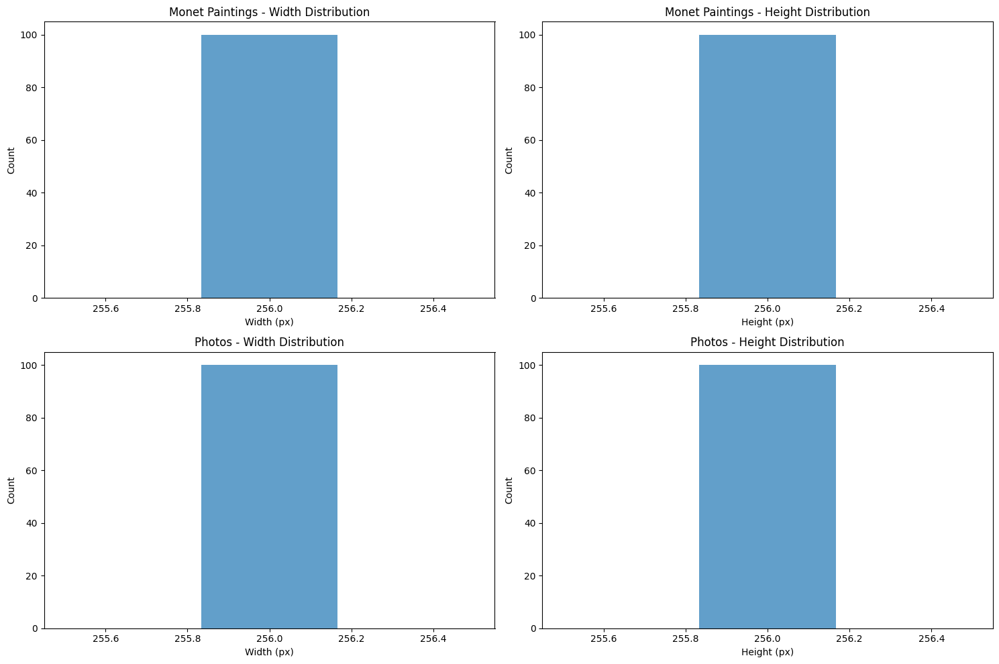

In [7]:
# Function to get image dimensions
def get_image_dimensions(image_paths):
    widths = []
    heights = []
    for path in image_paths:
        img = load_img(path)
        width, height = img.size
        widths.append(width)
        heights.append(height)
    return widths, heights

# Get dimensions for Monet paintings
monet_widths, monet_heights = get_image_dimensions(monet_jpg_files[:100])  # Limit to 100 images for speed

# Get dimensions for Photos
photo_widths, photo_heights = get_image_dimensions(photo_jpg_files[:100])  # Limit to 100 images for speed

# Plot dimension distributions
fig, axes = plt.subplots(2, 2, figsize=(15, 10))

# Monet dimensions
axes[0, 0].hist(monet_widths, bins=3, alpha=0.7)
axes[0, 0].set_title('Monet Paintings - Width Distribution')
axes[0, 0].set_xlabel('Width (px)')
axes[0, 0].set_ylabel('Count')

axes[0, 1].hist(monet_heights, bins=3, alpha=0.7)
axes[0, 1].set_title('Monet Paintings - Height Distribution')
axes[0, 1].set_xlabel('Height (px)')
axes[0, 1].set_ylabel('Count')

# Photo dimensions
axes[1, 0].hist(photo_widths, bins=3, alpha=0.7)
axes[1, 0].set_title('Photos - Width Distribution')
axes[1, 0].set_xlabel('Width (px)')
axes[1, 0].set_ylabel('Count')

axes[1, 1].hist(photo_heights, bins=3, alpha=0.7)
axes[1, 1].set_title('Photos - Height Distribution')
axes[1, 1].set_xlabel('Height (px)')
axes[1, 1].set_ylabel('Count')

plt.tight_layout()
plt.show()

In [8]:
# Print some statistics
print("Monet Paintings:")
print(f"Width - Min: {min(monet_widths)}, Max: {max(monet_widths)}, Mean: {np.mean(monet_widths):.2f}")
print(f"Height - Min: {min(monet_heights)}, Max: {max(monet_heights)}, Mean: {np.mean(monet_heights):.2f}")
print("\nPhotos:")
print(f"Width - Min: {min(photo_widths)}, Max: {max(photo_widths)}, Mean: {np.mean(photo_widths):.2f}")
print(f"Height - Min: {min(photo_heights)}, Max: {max(photo_heights)}, Mean: {np.mean(photo_heights):.2f}")

Monet Paintings:
Width - Min: 256, Max: 256, Mean: 256.00
Height - Min: 256, Max: 256, Mean: 256.00

Photos:
Width - Min: 256, Max: 256, Mean: 256.00
Height - Min: 256, Max: 256, Mean: 256.00


### Pixel Intensity Distribution Analysis

--- Monet Pixel Intensity ---


2025-05-20 14:28:27.779745: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


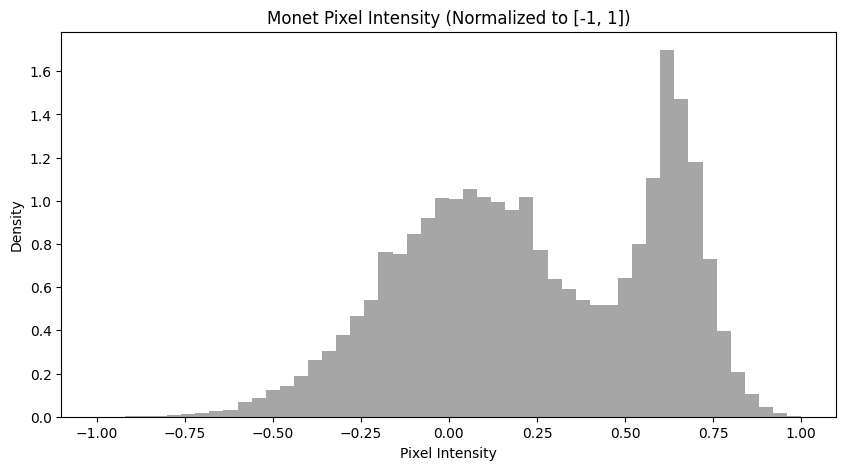


--- Photo Pixel Intensity ---


2025-05-20 14:28:27.837948: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


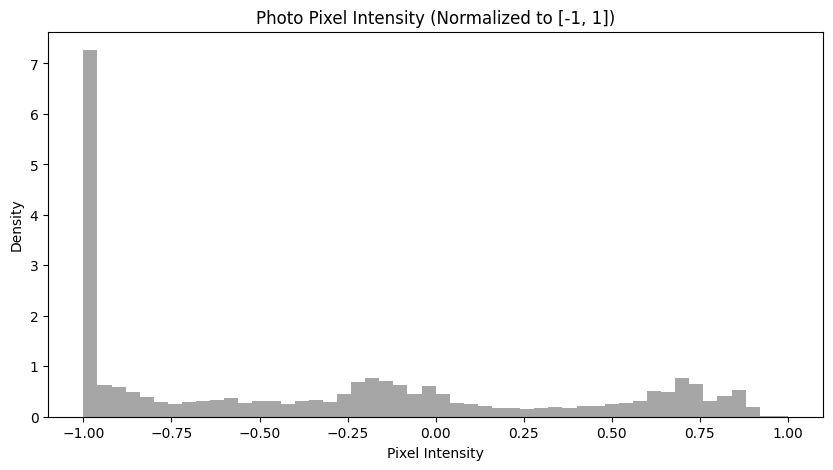

In [9]:
def plot_pixel_intensity_histograms(dataset, num_images_to_sample=50, title="Pixel Intensity"):
     pixels_list = []
     # Take a few batches to get enough images, then unbatch
     # Ensure dataset is not repeating for this sampling, or take limited number
     temp_ds = dataset.unbatch().take(num_images_to_sample)

     for img_tensor in temp_ds:
         pixels_list.append(img_tensor.numpy().flatten()) # Flatten to get all pixel values

     if not pixels_list:
         print(f"No images sampled for {title}.")
         return

     all_pixels = np.concatenate(pixels_list)

     plt.figure(figsize=(10, 5))
     plt.hist(all_pixels, bins=50, color='gray', alpha=0.7, density=True)
     # Images are normalized to [-1, 1]
     plt.title(f"{title} (Normalized to [-1, 1])")
     plt.xlabel("Pixel Intensity")
     plt.ylabel("Density")
     plt.show()
#
#
print("--- Monet Pixel Intensity ---")
plot_pixel_intensity_histograms(monet_ds, num_images_to_sample=100, title="Monet Pixel Intensity")
#
print("\n--- Photo Pixel Intensity ---")
plot_pixel_intensity_histograms(photo_ds, num_images_to_sample=100, title="Photo Pixel Intensity") 


### Color Distribution Analysis

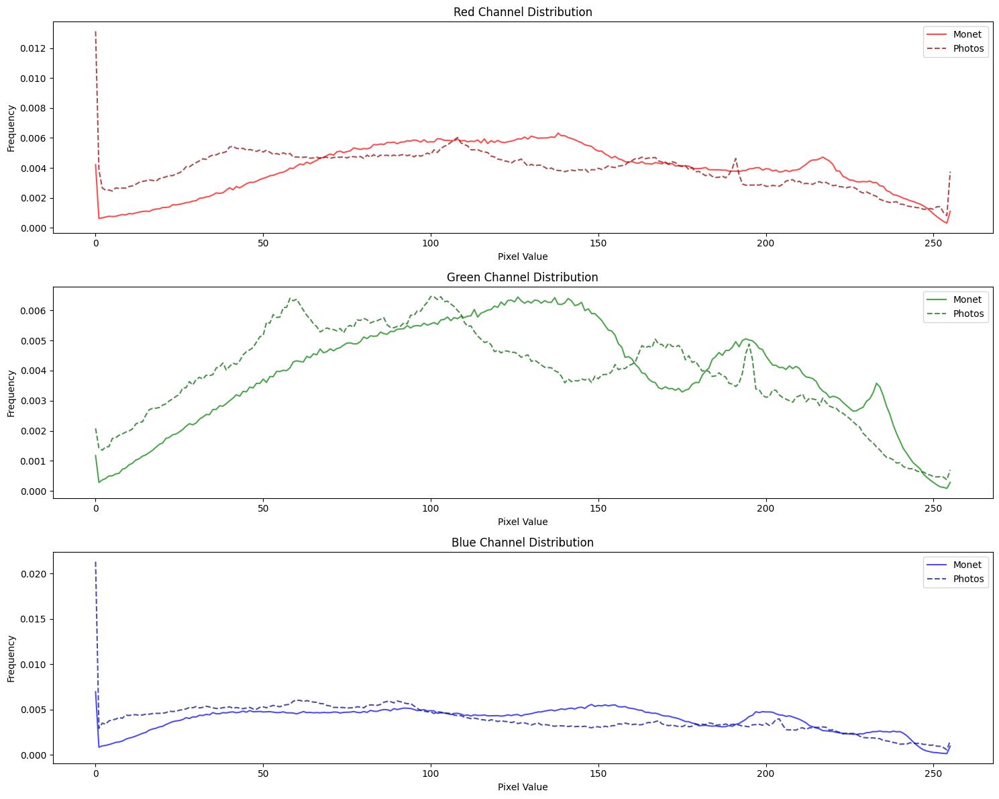

In [10]:
# Function to get average color histograms from a set of images
def get_avg_color_histogram(image_paths, sample_size=20):
    r_hist = np.zeros(256)
    g_hist = np.zeros(256)
    b_hist = np.zeros(256)
    
    # Sample a subset of images
    sample_paths = np.random.choice(image_paths, size=min(sample_size, len(image_paths)), replace=False)
    
    for path in sample_paths:
        img = img_to_array(load_img(path))
        img = img / 255.0  # Normalize to [0, 1]
        
        # Calculate histograms for each channel
        r_hist += np.histogram(img[:, :, 0].flatten(), bins=256, range=(0, 1))[0]
        g_hist += np.histogram(img[:, :, 1].flatten(), bins=256, range=(0, 1))[0]
        b_hist += np.histogram(img[:, :, 2].flatten(), bins=256, range=(0, 1))[0]
    
    # Normalize histograms
    r_hist = r_hist / r_hist.sum()
    g_hist = g_hist / g_hist.sum()
    b_hist = b_hist / b_hist.sum()
    
    return r_hist, g_hist, b_hist

# Get color histograms
monet_r, monet_g, monet_b = get_avg_color_histogram(monet_jpg_files)
photo_r, photo_g, photo_b = get_avg_color_histogram(photo_jpg_files)

# Plot color distributions
fig, axes = plt.subplots(3, 1, figsize=(15, 12))

# Red channel
axes[0].plot(monet_r, color='red', alpha=0.7, label='Monet')
axes[0].plot(photo_r, color='darkred', alpha=0.7, linestyle='--', label='Photos')
axes[0].set_title('Red Channel Distribution')
axes[0].set_xlabel('Pixel Value')
axes[0].set_ylabel('Frequency')
axes[0].legend()

# Green channel
axes[1].plot(monet_g, color='green', alpha=0.7, label='Monet')
axes[1].plot(photo_g, color='darkgreen', alpha=0.7, linestyle='--', label='Photos')
axes[1].set_title('Green Channel Distribution')
axes[1].set_xlabel('Pixel Value')
axes[1].set_ylabel('Frequency')
axes[1].legend()

# Blue channel
axes[2].plot(monet_b, color='blue', alpha=0.7, label='Monet')
axes[2].plot(photo_b, color='darkblue', alpha=0.7, linestyle='--', label='Photos')
axes[2].set_title('Blue Channel Distribution')
axes[2].set_xlabel('Pixel Value')
axes[2].set_ylabel('Frequency')
axes[2].legend()

plt.tight_layout()
plt.show()

### Average Color Analysis (R, G, B Channels)


--- Monet Paintings ---
Average Red: 159.67 ± 8.77
Average Green: 167.96 ± 7.47
Average Blue: 147.44 ± 6.98


2025-05-20 14:28:28.070464: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


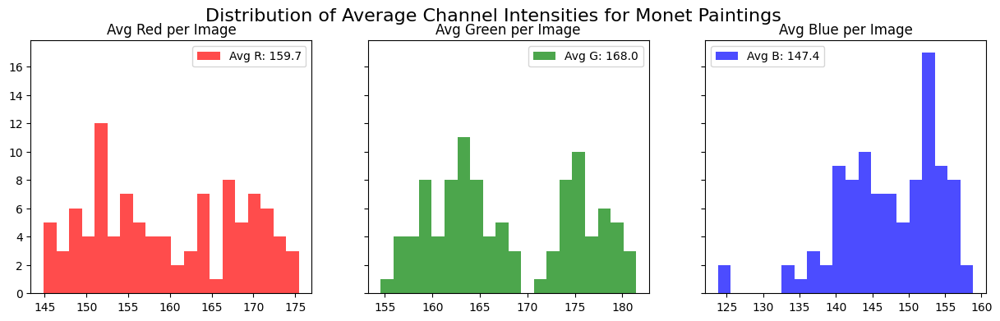

2025-05-20 14:28:28.181673: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence



--- Photographs ---
Average Red: 10.83 ± 9.28
Average Green: 85.25 ± 5.24
Average Blue: 165.39 ± 13.05


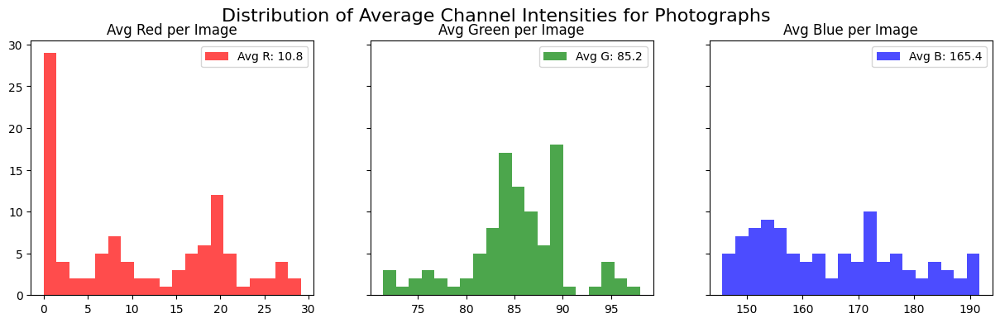

In [11]:
def calculate_average_colors(dataset, num_images_to_sample=100, title="Average Colors"):
     # Denormalize images to [0, 255] for intuitive color stats
     # Accumulate R, G, B means
     r_means, g_means, b_means = [], [], []

     temp_ds = dataset.unbatch().take(num_images_to_sample)

     for img_tensor in temp_ds:
         img_numpy = (img_tensor.numpy() * 0.5 + 0.5) * 255.0 # Denormalize to [0, 255]
         r_means.append(np.mean(img_numpy[:, 0]))
         g_means.append(np.mean(img_numpy[:, 1]))
         b_means.append(np.mean(img_numpy[:, 2]))

     if not r_means:
         print(f"No images sampled for {title} color analysis.")
         return
#
     avg_r, avg_g, avg_b = np.mean(r_means), np.mean(g_means), np.mean(b_means)
     std_r, std_g, std_b = np.std(r_means), np.std(g_means), np.std(b_means)
#
     print(f"\n--- {title} ---")
     print(f"Average Red: {avg_r:.2f} ± {std_r:.2f}")
     print(f"Average Green: {avg_g:.2f} ± {std_g:.2f}")
     print(f"Average Blue: {avg_b:.2f} ± {std_b:.2f}")
#
#     # Plot distribution of average channel values
     fig, axs = plt.subplots(1, 3, figsize=(15, 4), sharey=True)
     axs[0].hist(r_means, bins=20, color='red', alpha=0.7, label=f'Avg R: {avg_r:.1f}')
     axs[0].set_title('Avg Red per Image'); axs[0].legend()
     axs[1].hist(g_means, bins=20, color='green', alpha=0.7, label=f'Avg G: {avg_g:.1f}')
     axs[1].set_title('Avg Green per Image'); axs[1].legend()
     axs[2].hist(b_means, bins=20, color='blue', alpha=0.7, label=f'Avg B: {avg_b:.1f}')
     axs[2].set_title('Avg Blue per Image'); axs[2].legend()
     fig.suptitle(f"Distribution of Average Channel Intensities for {title}", fontsize=16)
     plt.show()
#
calculate_average_colors(monet_ds, num_images_to_sample=100, title="Monet Paintings")
calculate_average_colors(photo_ds, num_images_to_sample=100, title="Photographs")

### Edge and Texture Complexity (Visual Comparison using Sobel Filter)

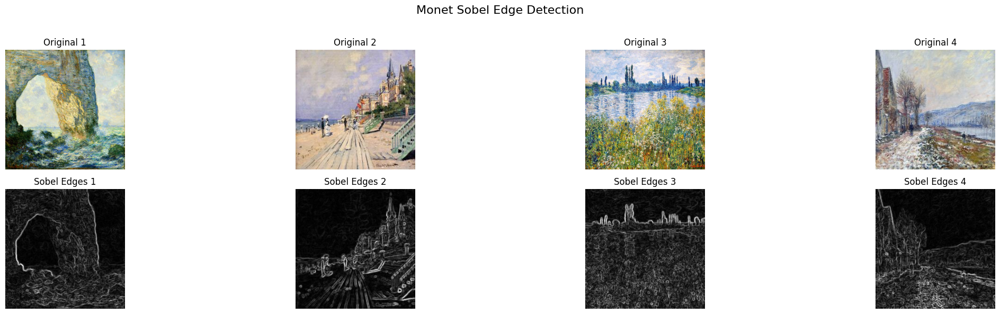

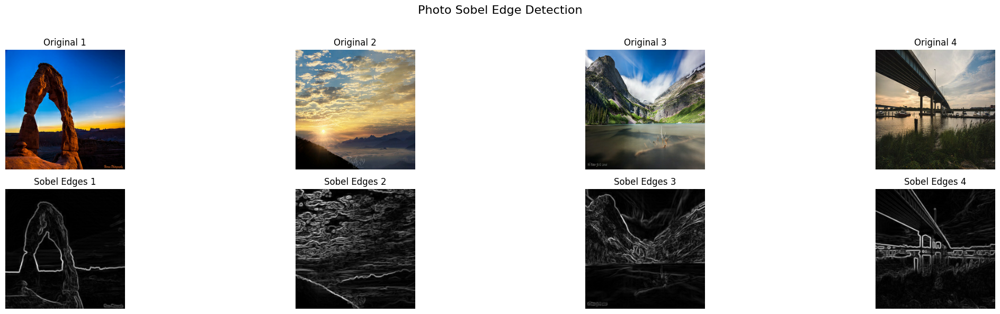

In [12]:
import cv2

def display_sobel_edges(dataset, num_samples=3, title="Sobel Edge Detection"):
     plt.figure(figsize=(num_samples * 6, 6)) # Wider for side-by-side
     sample_images = next(iter(dataset.unbatch().take(num_samples * 2))) # Take enough images

     for i in range(num_samples):
         original_img_tensor = next(iter(dataset.unbatch().skip(i*10).take(1))) # Skip some to get variety
         original_img = (original_img_tensor.numpy() * 0.5 + 0.5) * 255.0 # Denormalize to [0, 255]
         original_img_uint8 = original_img.astype(np.uint8)

         # Convert to grayscale for Sobel
         gray_img = cv2.cvtColor(original_img_uint8, cv2.COLOR_RGB2GRAY)

         # Sobel edge detection
         sobelx = cv2.Sobel(gray_img, cv2.CV_64F, 1, 0, ksize=5) # x-direction
         sobely = cv2.Sobel(gray_img, cv2.CV_64F, 0, 1, ksize=5) # y-direction
         sobel_magnitude = np.sqrt(sobelx**2 + sobely**2)
         sobel_magnitude = (sobel_magnitude / np.max(sobel_magnitude) * 255).astype(np.uint8) # Normalize to 0-255

         plt.subplot(2, num_samples, i + 1)
         plt.imshow(original_img_uint8)
         plt.title(f"Original {i+1}")
         plt.axis('off')

         plt.subplot(2, num_samples, i + num_samples + 1)
         plt.imshow(sobel_magnitude, cmap='gray')
         plt.title(f"Sobel Edges {i+1}")
         plt.axis('off')

     plt.suptitle(title, fontsize=16)
     plt.tight_layout(rect=[0, 0, 1, 0.96])
     plt.show()


display_sobel_edges(monet_ds.batch(1), num_samples=4, title="Monet Sobel Edge Detection")
display_sobel_edges(photo_ds.batch(1), num_samples=4, title="Photo Sobel Edge Detection")

## Data PreProcessing

In [13]:
# Data augmentation function
def data_augmentation(image):
    # Random flip
    image = tf.image.random_flip_left_right(image)
    
    # Random crop and resize
    image = tf.image.resize(image, [286, 286])  # Resize larger
    image = tf.image.random_crop(image, size=[IMAGE_SIZE[0], IMAGE_SIZE[1], 3])  # Then crop
    
    # Small random brightness/contrast changes
    image = tf.image.random_brightness(image, max_delta=0.1)
    image = tf.image.random_contrast(image, lower=0.9, upper=1.1)
    
    # Ensure values stay in [-1, 1]
    image = tf.clip_by_value(image, -1, 1)
    
    return image

# Apply data augmentation
monet_ds = monet_ds.map(data_augmentation, num_parallel_calls=AUTOTUNE)
photo_ds = photo_ds.map(data_augmentation, num_parallel_calls=AUTOTUNE)

# Cache, shuffle and batch datasets for training
BUFFER_SIZE = 1000
BATCH_SIZE=1

# Prepare datasets for training
monet_ds = monet_ds.shuffle(BUFFER_SIZE).batch(BATCH_SIZE).cache()
photo_ds = photo_ds.shuffle(BUFFER_SIZE).batch(BATCH_SIZE).cache()

# Make datasets repeat indefinitely for training
monet_ds = monet_ds.repeat()
photo_ds = photo_ds.repeat()

# Prefetch for performance
monet_ds = monet_ds.prefetch(AUTOTUNE)
photo_ds = photo_ds.prefetch(AUTOTUNE)

### Visualize Augmented Images

Monet Augmented Samples:


2025-05-20 14:28:28.832437: W tensorflow/core/kernels/data/cache_dataset_ops.cc:858] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.
2025-05-20 14:28:28.839444: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


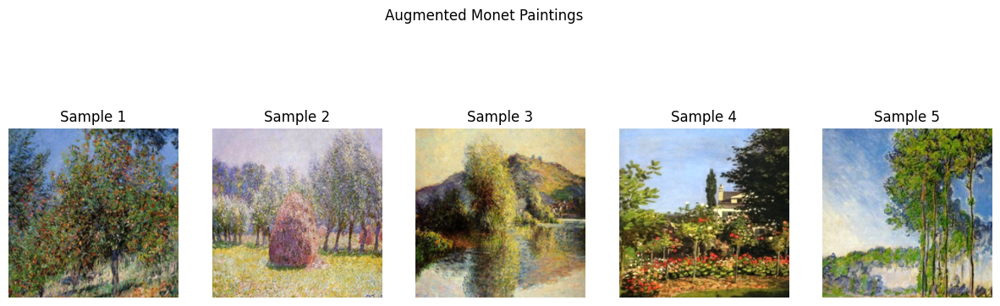

Photo Augmented Samples:


2025-05-20 14:28:29.064406: W tensorflow/core/kernels/data/cache_dataset_ops.cc:858] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.
2025-05-20 14:28:29.100149: W tensorflow/core/framework/local_rendezvous.cc:404] Local rendezvous is aborting with status: OUT_OF_RANGE: End of sequence


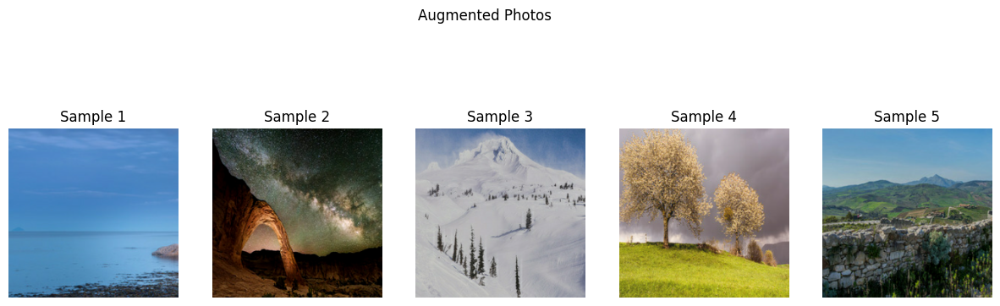

In [14]:
# Visualize a few augmented examples
def visualize_augmented_samples(dataset, num_examples=5, title="Augmented Images"):
    samples = []
    for image in dataset.take(num_examples):
        samples.append(image[0])  # Get the first image from batch
    
    plt.figure(figsize=(15, 5))
    for i, sample in enumerate(samples):
        # Convert from [-1, 1] to [0, 1]
        sample = (sample + 1) / 2.0
        plt.subplot(1, num_examples, i+1)
        plt.imshow(sample)
        plt.title(f"Sample {i+1}")
        plt.axis('off')
    plt.suptitle(title)
    plt.show()

print("Monet Augmented Samples:")
visualize_augmented_samples(monet_ds, title="Augmented Monet Paintings")

print("Photo Augmented Samples:")
visualize_augmented_samples(photo_ds, title="Augmented Photos")

## Model Architecture

I'll implement a CycleGAN model, which consists of:
1. Two generators: one for Photo -> Monet and one for Monet -> Photo
2. Two discriminators: one for Monet domain and one for Photo domain

In [15]:
# Downsampling block for the generator
def downsample(filters, size, apply_batchnorm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    
    result = keras.Sequential()
    result.add(layers.Conv2D(filters, size, strides=2, padding='same',
                            kernel_initializer=initializer, use_bias=False))
    
    if apply_batchnorm:
        result.add(layers.BatchNormalization())
    
    result.add(layers.LeakyReLU(0.2))
    
    return result

# Upsampling block for the generator
def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    
    result = keras.Sequential()
    result.add(layers.Conv2DTranspose(filters, size, strides=2, padding='same',
                                    kernel_initializer=initializer, use_bias=False))
    
    result.add(layers.BatchNormalization())
    
    if apply_dropout:
        result.add(layers.Dropout(0.5))
    
    result.add(layers.ReLU())
    
    return result

# Residual block for the generator
def residual_block(input_tensor, filters, size=3):
    initializer = tf.random_normal_initializer(0., 0.02)
    x = input_tensor
    
    x = layers.Conv2D(filters, size, padding='same', 
                    kernel_initializer=initializer, use_bias=False)(x)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)
    
    x = layers.Conv2D(filters, size, padding='same',
                    kernel_initializer=initializer, use_bias=False)(x)
    x = layers.BatchNormalization()(x)
    
    # Add skip connection
    return layers.add([input_tensor, x])

# Generator model with ResNet blocks (ResNet generator)
def build_generator():
    inputs = layers.Input(shape=[IMAGE_SIZE[0], IMAGE_SIZE[1], 3])
    
    # Initial downsampling
    x = layers.Conv2D(64, 7, padding='same', use_bias=False)(inputs)
    x = layers.BatchNormalization()(x)
    x = layers.ReLU()(x)
    
    # Downsampling
    x = downsample(128, 3)(x)  # (128, 128, 128)
    x = downsample(256, 3)(x)  # (64, 64, 256)
    
    # 9 Residual blocks
    for _ in range(9):
        x = residual_block(x, 256)
    
    # Upsampling
    x = upsample(128, 3)(x)  # (128, 128, 128)
    x = upsample(64, 3)(x)   # (256, 256, 64)
    
    # Final layer with tanh activation
    x = layers.Conv2D(3, 7, padding='same', activation='tanh')(x)  # (256, 256, 3)
    
    return keras.Model(inputs=inputs, outputs=x)

# PatchGAN discriminator
def build_discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)
    
    inp = layers.Input(shape=[IMAGE_SIZE[0], IMAGE_SIZE[1], 3], name='input_image')
    
    # Downsampling layers
    x = layers.Conv2D(64, 4, strides=2, padding='same',
                    kernel_initializer=initializer)(inp)  # (128, 128, 64)
    x = layers.LeakyReLU(0.2)(x)
    
    x = layers.Conv2D(128, 4, strides=2, padding='same',
                    kernel_initializer=initializer, use_bias=False)(x)  # (64, 64, 128)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU(0.2)(x)
    
    x = layers.Conv2D(256, 4, strides=2, padding='same',
                    kernel_initializer=initializer, use_bias=False)(x)  # (32, 32, 256)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU(0.2)(x)
    
    x = layers.Conv2D(512, 4, strides=1, padding='same',
                    kernel_initializer=initializer, use_bias=False)(x)  # (32, 32, 512)
    x = layers.BatchNormalization()(x)
    x = layers.LeakyReLU(0.2)(x)
    
    # Final layer (output 1-channel PatchGAN)
    x = layers.Conv2D(1, 4, strides=1, padding='same',
                    kernel_initializer=initializer)(x)  # (32, 32, 1)
    
    return keras.Model(inputs=inp, outputs=x)

# Instantiate the models
generator_g = build_generator()  # Photo to Monet
generator_f = build_generator()  # Monet to Photo

discriminator_x = build_discriminator()  # Discriminator for Monet
discriminator_y = build_discriminator()  # Discriminator for Photos

# Print model summaries
generator_g.summary()
discriminator_x.summary()

Model: "functional_4"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 256, 256,  │      9,408 │ input_layer[0][0] │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalization │ (None, 256, 256,  │        256 │ conv2d[0][0]      │
│ (BatchNormalizatio… │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu (ReLU)        │ (None, 256, 256,  │          0 │ batch_normalizat… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential          │ (None, 128, 128,  │     74,240 │ re_lu[0][0]       │
│ (Sequential)        │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ sequential_1        │ (None, 64, 64,    │    295,936 │ sequential[0][0]  │
│ (Sequential)        │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 64, 64,    │    589,824 │ sequential_1[0][… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 64, 64,    │      1,024 │ conv2d_3[0][0]    │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_1 (ReLU)      │ (None, 64, 64,    │          0 │ batch_normalizat… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, 64, 64,    │    589,824 │ re_lu_1[0][0]     │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 64, 64,    │      1,024 │ conv2d_4[0][0]    │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ add (Add)           │ (None, 64, 64,    │          0 │ sequential_1[0][… │
│                     │ 256)              │            │ batch_normalizat… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_5 (Conv2D)   │ (None, 64, 64,    │    589,824 │ add[0][0]         │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 64, 64,    │      1,024 │ conv2d_5[0][0]    │
│ (BatchNormalizatio… │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ re_lu_2 (ReLU)      │ (None, 64, 64,    │          0 │ batch_normalizat… │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_6 (Conv2D)   │ (None, 64, 64,    │    589,824 │ re_lu_2[0][0]     │
│                     │ 256)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ batch_normalizatio… │ (None, 64, 64,    │      1,024 │ conv2d_6[0][0]  

 Total params: 11,393,923 (43.46 MB)

 Trainable params: 11,383,427 (43.42 MB)

 Non-trainable params: 10,496 (41.00 KB)

Model: "functional_10"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_image (InputLayer)        │ (None, 256, 256, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_44 (Conv2D)              │ (None, 128, 128, 64)   │         3,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_4 (LeakyReLU)       │ (None, 128, 128, 64)   │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_45 (Conv2D)              │ (None, 64, 64, 128)    │       131,072 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_46          │ (None, 64, 64, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_5 (LeakyReLU)       │ (None, 64, 64, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_46 (Conv2D)              │ (None, 32, 32, 256)    │       524,288 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_47          │ (None, 32, 32, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_6 (LeakyReLU)       │ (None, 32, 32, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_47 (Conv2D)              │ (None, 32, 32, 512)    │     2,097,152 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_48          │ (None, 32, 32, 512)    │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_7 (LeakyReLU)       │ (None, 32, 32, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_48 (Conv2D)              │ (None, 32, 32, 1)      │         8,193 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 2,767,425 (10.56 MB)

 Trainable params: 2,765,633 (10.55 MB)

 Non-trainable params: 1,792 (7.00 KB)

## Loss Functions and Optimizers

In [16]:
# Define the loss functions
def discriminator_loss(real, generated):
    real_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)(tf.ones_like(real), real)
    generated_loss = tf.keras.losses.BinaryCrossentropy(from_logits=True)(tf.zeros_like(generated), generated)
    total_loss = real_loss + generated_loss
    return total_loss * 0.5

def generator_loss(generated):
    return tf.keras.losses.BinaryCrossentropy(from_logits=True)(tf.ones_like(generated), generated)

def calc_cycle_loss(real_image, cycled_image, lambda_value=10):
    return lambda_value * tf.reduce_mean(tf.abs(real_image - cycled_image))

def identity_loss(real_image, same_image, lambda_value=5):
    return lambda_value * 0.5 * tf.reduce_mean(tf.abs(real_image - same_image))

# Define the optimizers for each model
generator_g_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
generator_f_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

discriminator_x_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_y_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)


## Checkpoints

In [17]:
# Define checkpoints for saving model progress
checkpoint_prefix = "ckpt"
checkpoint = tf.train.Checkpoint(
    generator_g=generator_g,
    generator_f=generator_f,
    discriminator_x=discriminator_x,
    discriminator_y=discriminator_y,
    generator_g_optimizer=generator_g_optimizer,
    generator_f_optimizer=generator_f_optimizer,
    discriminator_x_optimizer=discriminator_x_optimizer,
    discriminator_y_optimizer=discriminator_y_optimizer
)

## Training Functions

In [18]:
def train_step(real_x, real_y):
    # real_x: Monet, real_y: Photo
    with tf.GradientTape(persistent=True) as tape:
        # Generators G: Photo -> Monet, F: Monet -> Photo
        
        # Generator G translates Photos (Y) to Monet style (X)
        fake_x = generator_g(real_y, training=True)
        # Generator F translates Monet (X) to Photo style (Y)
        fake_y = generator_f(real_x, training=True)
        
        # Cycle consistency (reconstruct original images)
        cycled_x = generator_f(fake_x, training=True)  # Y -> X -> Y
        cycled_y = generator_g(fake_y, training=True)  # X -> Y -> X
        
        # Identity mapping (optional, helps preserve color composition)
        same_x = generator_g(real_x, training=True)  # X -> X
        same_y = generator_f(real_y, training=True)  # Y -> Y
        
        # Discriminator outputs
        disc_real_x = discriminator_x(real_x, training=True)
        disc_fake_x = discriminator_x(fake_x, training=True)
        
        disc_real_y = discriminator_y(real_y, training=True)
        disc_fake_y = discriminator_y(fake_y, training=True)
        
        # Generator losses
        gen_g_loss = generator_loss(disc_fake_x)  # Photo -> Monet generator loss
        gen_f_loss = generator_loss(disc_fake_y)  # Monet -> Photo generator loss
        
        # Cycle consistency losses
        cycle_loss_x = calc_cycle_loss(real_x, cycled_x)
        cycle_loss_y = calc_cycle_loss(real_y, cycled_y)
        total_cycle_loss = cycle_loss_x + cycle_loss_y
        
        # Identity losses (optional)
        id_loss_x = identity_loss(real_x, same_x)
        id_loss_y = identity_loss(real_y, same_y)
        
        # Total generator losses
        total_gen_g_loss = gen_g_loss + total_cycle_loss + id_loss_x
        total_gen_f_loss = gen_f_loss + total_cycle_loss + id_loss_y
        
        # Discriminator losses
        disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x)
        disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y)
    
    # Calculate gradients and apply to optimizers
    # Generator G gradients
    generator_g_gradients = tape.gradient(total_gen_g_loss, generator_g.trainable_variables)
    generator_g_optimizer.apply_gradients(zip(generator_g_gradients, generator_g.trainable_variables))
    
    # Generator F gradients
    generator_f_gradients = tape.gradient(total_gen_f_loss, generator_f.trainable_variables)
    generator_f_optimizer.apply_gradients(zip(generator_f_gradients, generator_f.trainable_variables))
    
    # Discriminator X gradients
    discriminator_x_gradients = tape.gradient(disc_x_loss, discriminator_x.trainable_variables)
    discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients, discriminator_x.trainable_variables))
    
    # Discriminator Y gradients
    discriminator_y_gradients = tape.gradient(disc_y_loss, discriminator_y.trainable_variables)
    discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients, discriminator_y.trainable_variables))
    
    return {
        'gen_g_loss': total_gen_g_loss,
        'gen_f_loss': total_gen_f_loss,
        'disc_x_loss': disc_x_loss,
        'disc_y_loss': disc_y_loss
    }

# Function to generate sample images during training
def generate_images(model, test_input, typ=1):
    prediction = model(test_input)
    
    plt.figure(figsize=(12, 6))
    
    display_list = [test_input[0], prediction[0]]
    if typ==1:
        title = ['Input Photo', 'Generated Monet-style Image']
    else:
        title = ['Input Monet-style Image', 'Generated Photo']
    
    for i in range(2):
        plt.subplot(1, 2, i+1)
        plt.title(title[i])
        # Convert from [-1, 1] to [0, 1]
        img = (display_list[i] + 1) / 2.0
        plt.imshow(img)
        plt.axis('off')
    
    plt.tight_layout()
    plt.show()

## Training Model

Starting training...


2025-05-20 14:28:29.772602: W tensorflow/core/kernels/data/cache_dataset_ops.cc:858] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.
2025-05-20 14:28:29.921068: W tensorflow/core/kernels/data/cache_dataset_ops.cc:858] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


Epoch 1/10, Step 0/300
  gen_g_loss: 15.3223
  gen_f_loss: 15.4288
  disc_x_loss: 0.8819
  disc_y_loss: 0.8626
Epoch 1/10, Step 50/300
  gen_g_loss: 9.5554
  gen_f_loss: 10.5437
  disc_x_loss: 0.6577
  disc_y_loss: 0.4023
Epoch 1/10, Step 100/300
  gen_g_loss: 10.7615
  gen_f_loss: 10.1533
  disc_x_loss: 0.3499
  disc_y_loss: 0.4508
Epoch 1/10, Step 150/300
  gen_g_loss: 10.2082
  gen_f_loss: 9.9479
  disc_x_loss: 0.6846
  disc_y_loss: 0.5471
Epoch 1/10, Step 200/300
  gen_g_loss: 12.4017
  gen_f_loss: 12.4251
  disc_x_loss: 0.2599
  disc_y_loss: 0.4930
Epoch 1/10, Step 250/300
  gen_g_loss: 11.8602
  gen_f_loss: 10.4245
  disc_x_loss: 0.7556
  disc_y_loss: 0.4723


2025-05-20 14:36:39.215079: W tensorflow/core/kernels/data/cache_dataset_ops.cc:858] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


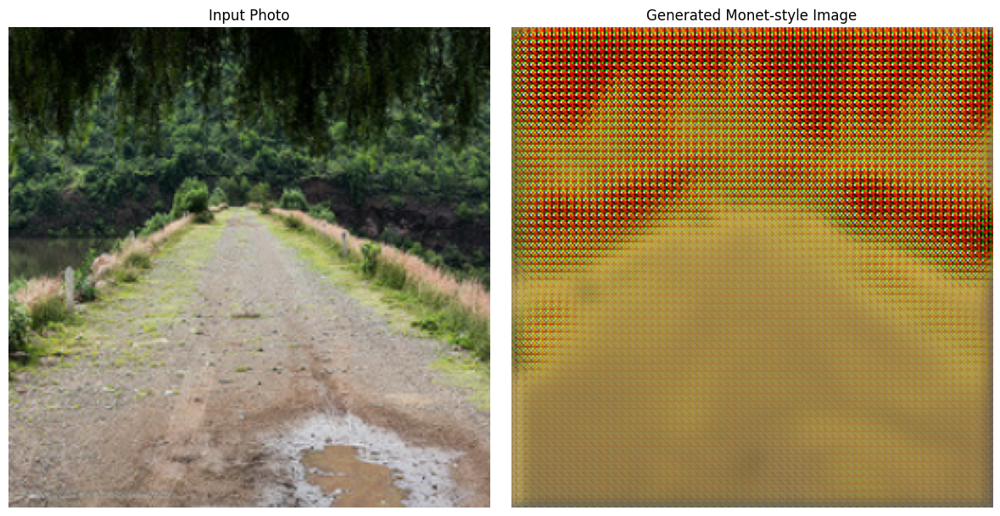

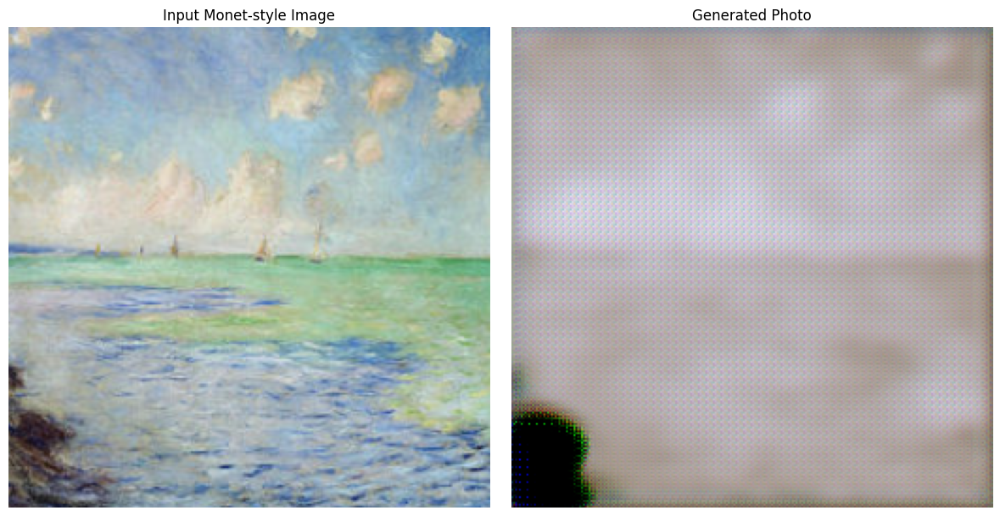

--------------------------------------
Time taken for epoch 1: 489.51 sec
Generator G loss: 11.6472
Generator F loss: 11.4865
Discriminator X loss: 0.5281
Discriminator Y loss: 0.6075
--------------------------------------
Epoch 2/10, Step 0/300
  gen_g_loss: 11.8494
  gen_f_loss: 13.0846
  disc_x_loss: 0.2810
  disc_y_loss: 0.2544
Epoch 2/10, Step 50/300
  gen_g_loss: 10.2995
  gen_f_loss: 9.3774
  disc_x_loss: 0.2363
  disc_y_loss: 0.4208
Epoch 2/10, Step 100/300
  gen_g_loss: 10.9735
  gen_f_loss: 12.6032
  disc_x_loss: 0.3905
  disc_y_loss: 0.1978
Epoch 2/10, Step 150/300
  gen_g_loss: 12.0347
  gen_f_loss: 12.2437
  disc_x_loss: 0.7832
  disc_y_loss: 0.2711
Epoch 2/10, Step 200/300
  gen_g_loss: 12.2436
  gen_f_loss: 12.8965
  disc_x_loss: 0.3663
  disc_y_loss: 0.6732
Epoch 2/10, Step 250/300
  gen_g_loss: 10.3629
  gen_f_loss: 9.7206
  disc_x_loss: 0.2950
  disc_y_loss: 0.7020


2025-05-20 14:44:46.979021: W tensorflow/core/kernels/data/cache_dataset_ops.cc:858] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


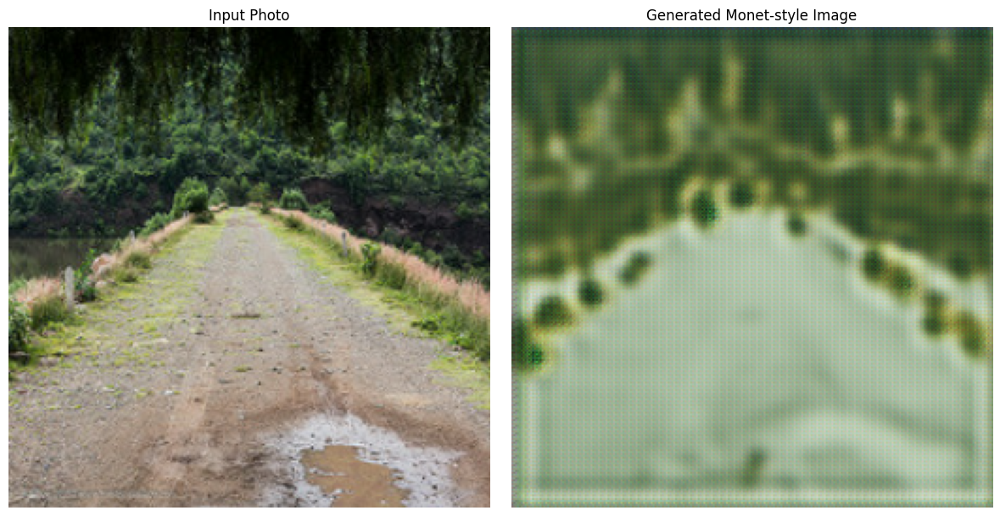

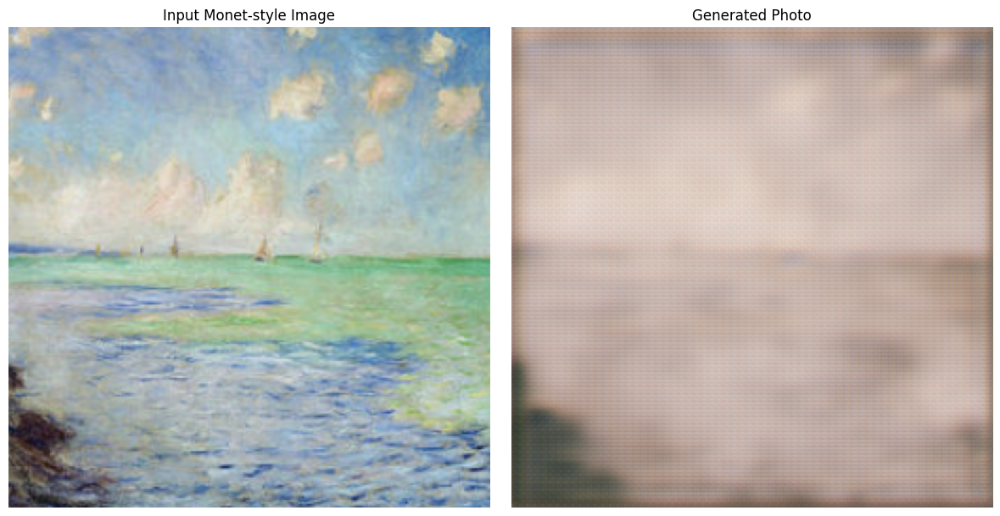

--------------------------------------
Time taken for epoch 2: 487.75 sec
Generator G loss: 11.6638
Generator F loss: 11.4097
Discriminator X loss: 0.4255
Discriminator Y loss: 0.4936
--------------------------------------
Epoch 3/10, Step 0/300
  gen_g_loss: 11.8016
  gen_f_loss: 11.3297
  disc_x_loss: 0.4100
  disc_y_loss: 0.5452
Epoch 3/10, Step 50/300
  gen_g_loss: 11.7406
  gen_f_loss: 13.2320
  disc_x_loss: 0.2235
  disc_y_loss: 0.2504
Epoch 3/10, Step 100/300
  gen_g_loss: 11.9843
  gen_f_loss: 11.4494
  disc_x_loss: 0.2729
  disc_y_loss: 0.8898
Epoch 3/10, Step 150/300
  gen_g_loss: 10.0945
  gen_f_loss: 9.9291
  disc_x_loss: 0.8232
  disc_y_loss: 0.1999
Epoch 3/10, Step 200/300
  gen_g_loss: 11.4968
  gen_f_loss: 9.8746
  disc_x_loss: 0.5576
  disc_y_loss: 0.3583
Epoch 3/10, Step 250/300
  gen_g_loss: 14.2286
  gen_f_loss: 12.1477
  disc_x_loss: 0.4374
  disc_y_loss: 0.5375


2025-05-20 14:52:52.964960: W tensorflow/core/kernels/data/cache_dataset_ops.cc:858] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


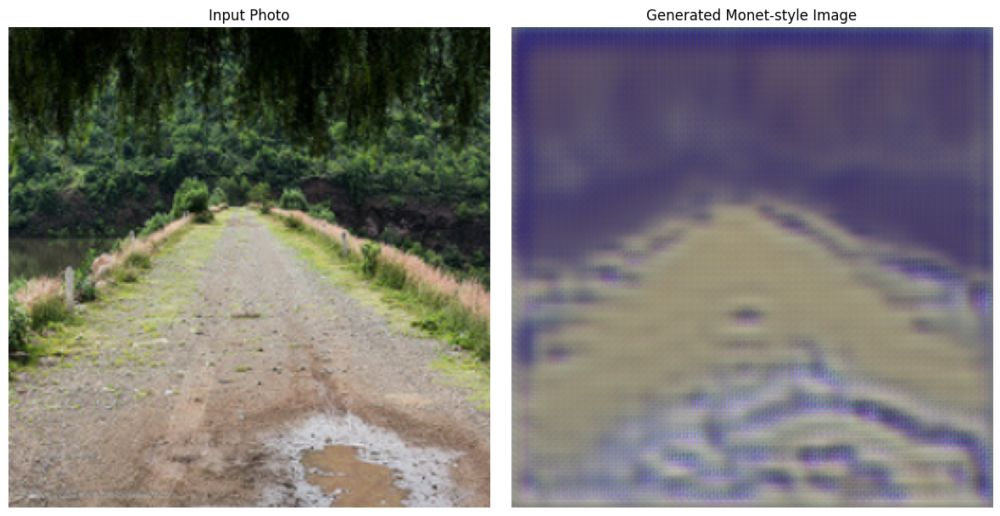

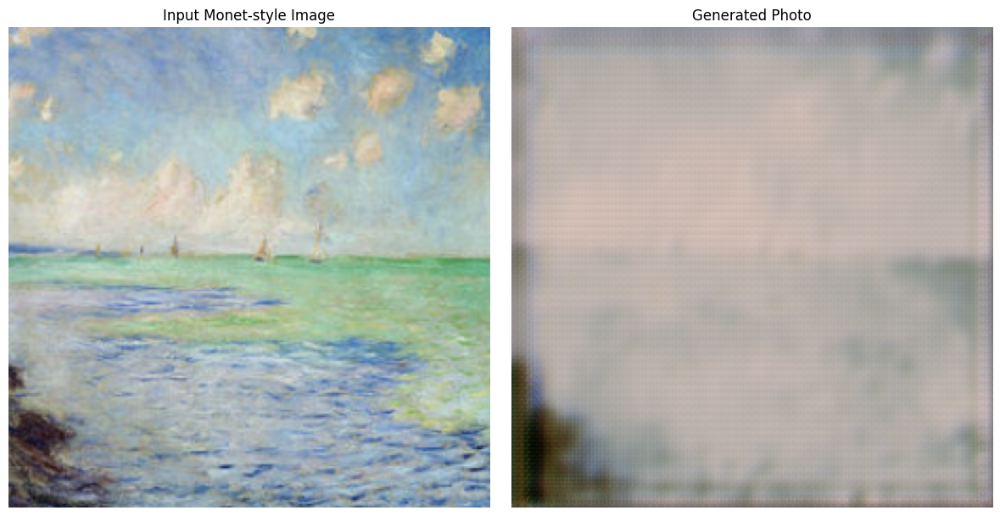

--------------------------------------
Time taken for epoch 3: 486.00 sec
Generator G loss: 12.1271
Generator F loss: 11.7434
Discriminator X loss: 0.3696
Discriminator Y loss: 0.4570
--------------------------------------
Epoch 4/10, Step 0/300
  gen_g_loss: 12.1257
  gen_f_loss: 11.2494
  disc_x_loss: 0.1733
  disc_y_loss: 0.3635
Epoch 4/10, Step 50/300
  gen_g_loss: 11.5116
  gen_f_loss: 10.9646
  disc_x_loss: 0.0487
  disc_y_loss: 0.6586
Epoch 4/10, Step 100/300
  gen_g_loss: 12.3889
  gen_f_loss: 11.8873
  disc_x_loss: 0.7875
  disc_y_loss: 0.8761
Epoch 4/10, Step 150/300
  gen_g_loss: 11.0827
  gen_f_loss: 9.6850
  disc_x_loss: 0.3218
  disc_y_loss: 0.4217
Epoch 4/10, Step 200/300
  gen_g_loss: 8.7963
  gen_f_loss: 9.2067
  disc_x_loss: 0.4610
  disc_y_loss: 0.1967
Epoch 4/10, Step 250/300
  gen_g_loss: 12.7868
  gen_f_loss: 12.2646
  disc_x_loss: 0.5109
  disc_y_loss: 0.2171


2025-05-20 15:00:55.397578: W tensorflow/core/kernels/data/cache_dataset_ops.cc:858] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


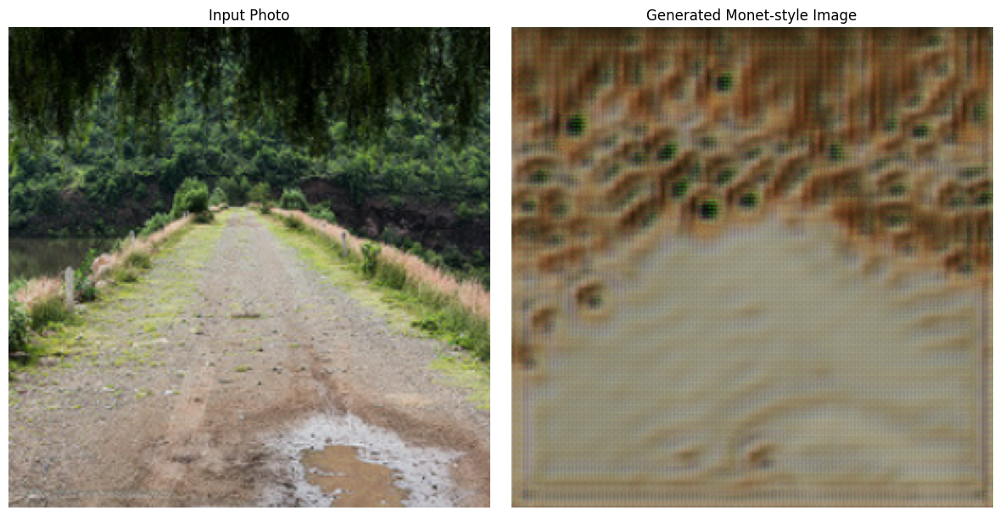

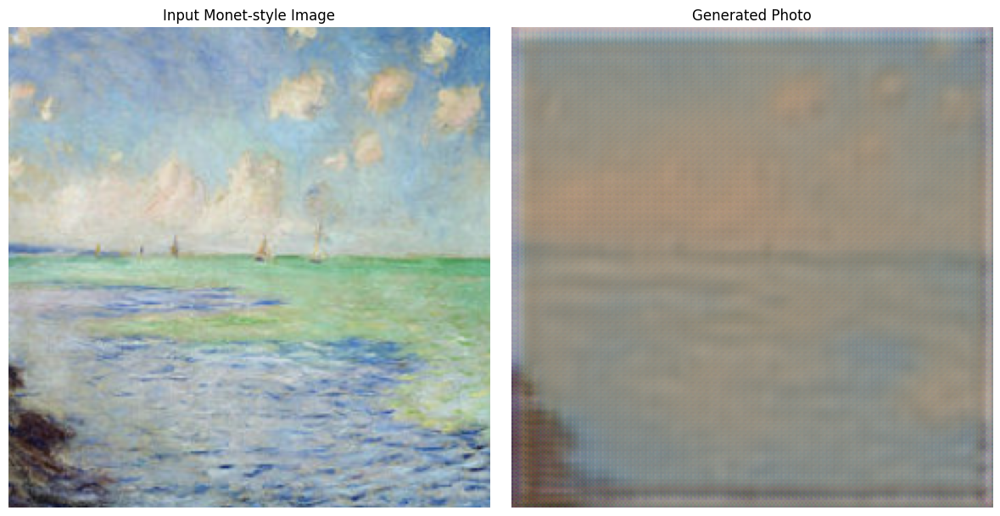

--------------------------------------
Time taken for epoch 4: 482.43 sec
Generator G loss: 11.6106
Generator F loss: 11.4442
Discriminator X loss: 0.4444
Discriminator Y loss: 0.4845
--------------------------------------
Epoch 5/10, Step 0/300
  gen_g_loss: 9.6420
  gen_f_loss: 10.4556
  disc_x_loss: 0.2876
  disc_y_loss: 0.7269
Epoch 5/10, Step 50/300
  gen_g_loss: 7.8966
  gen_f_loss: 9.2810
  disc_x_loss: 0.4976
  disc_y_loss: 0.4878
Epoch 5/10, Step 100/300
  gen_g_loss: 11.6207
  gen_f_loss: 11.3467
  disc_x_loss: 0.4213
  disc_y_loss: 0.4110
Epoch 5/10, Step 150/300
  gen_g_loss: 12.2578
  gen_f_loss: 13.3382
  disc_x_loss: 0.5384
  disc_y_loss: 0.2572
Epoch 5/10, Step 200/300
  gen_g_loss: 10.3815
  gen_f_loss: 11.9011
  disc_x_loss: 0.8200
  disc_y_loss: 0.8870
Epoch 5/10, Step 250/300
  gen_g_loss: 10.5867
  gen_f_loss: 10.0162
  disc_x_loss: 0.8282
  disc_y_loss: 0.4287


2025-05-20 15:08:59.228679: W tensorflow/core/kernels/data/cache_dataset_ops.cc:858] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


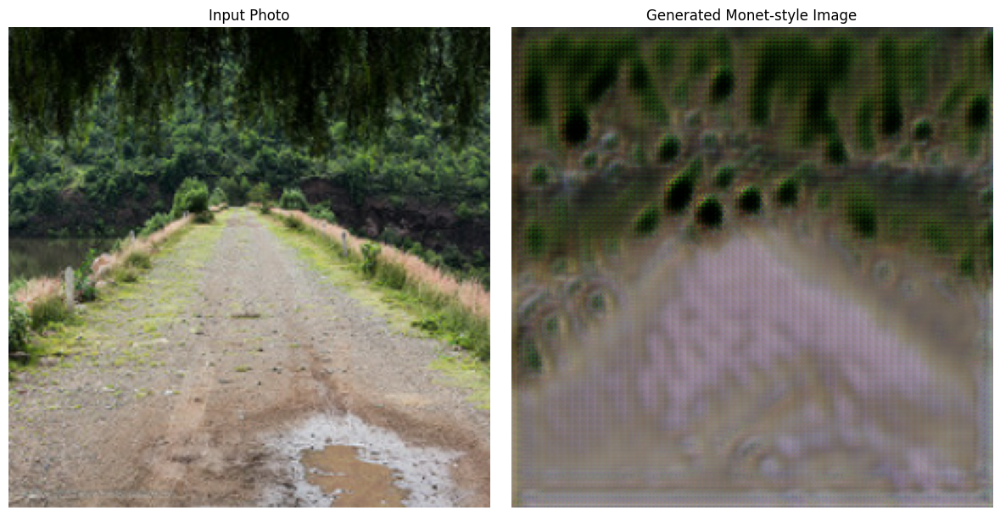

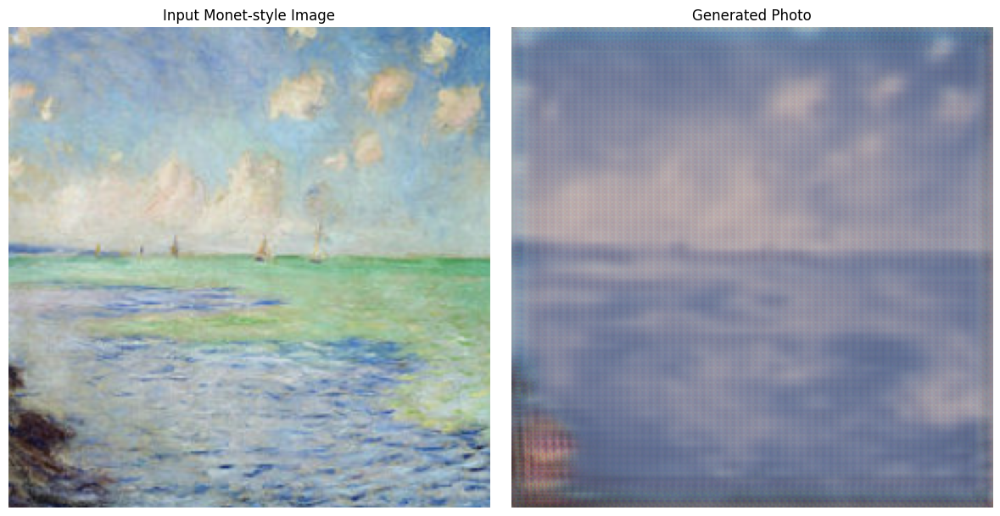

--------------------------------------
Time taken for epoch 5: 484.43 sec
Generator G loss: 10.9043
Generator F loss: 10.9273
Discriminator X loss: 0.5375
Discriminator Y loss: 0.5298
--------------------------------------
Epoch 6/10, Step 0/300
  gen_g_loss: 11.1629
  gen_f_loss: 11.2447
  disc_x_loss: 0.4210
  disc_y_loss: 1.1644
Epoch 6/10, Step 50/300
  gen_g_loss: 8.3385
  gen_f_loss: 9.5136
  disc_x_loss: 0.6361
  disc_y_loss: 0.4292
Epoch 6/10, Step 100/300
  gen_g_loss: 8.8131
  gen_f_loss: 8.4893
  disc_x_loss: 0.4500
  disc_y_loss: 0.8341
Epoch 6/10, Step 150/300
  gen_g_loss: 11.0498
  gen_f_loss: 10.6224
  disc_x_loss: 0.6998
  disc_y_loss: 0.6803
Epoch 6/10, Step 200/300
  gen_g_loss: 11.3977
  gen_f_loss: 11.8918
  disc_x_loss: 0.8670
  disc_y_loss: 1.1043
Epoch 6/10, Step 250/300
  gen_g_loss: 9.8853
  gen_f_loss: 10.4960
  disc_x_loss: 0.4552
  disc_y_loss: 0.3563


2025-05-20 15:17:03.274637: W tensorflow/core/kernels/data/cache_dataset_ops.cc:858] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


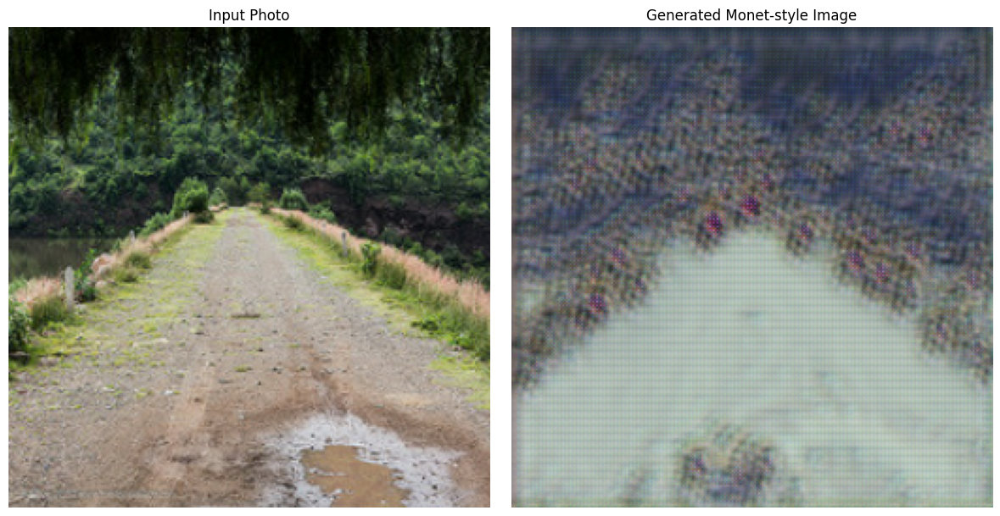

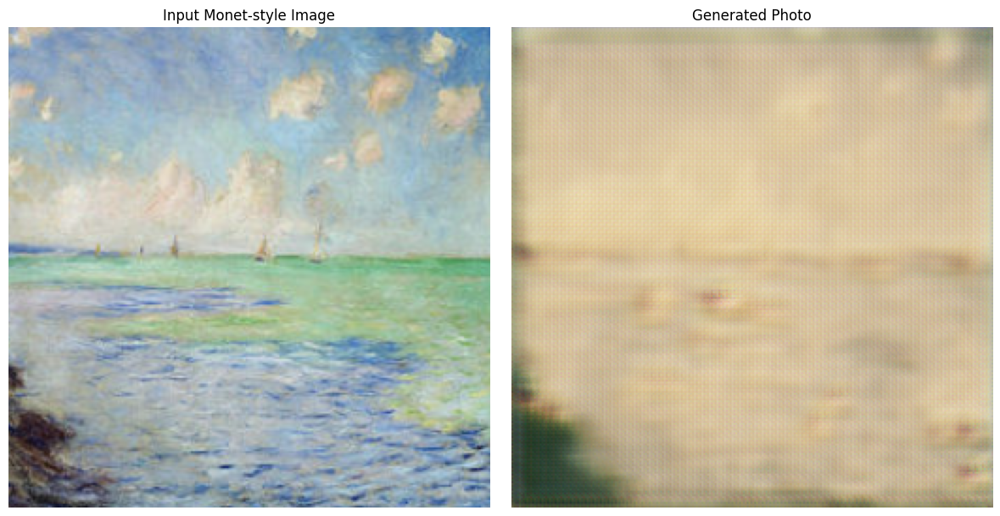

--------------------------------------
Time taken for epoch 6: 483.44 sec
Generator G loss: 10.8044
Generator F loss: 10.8291
Discriminator X loss: 0.5581
Discriminator Y loss: 0.5797
--------------------------------------
Epoch 7/10, Step 0/300
  gen_g_loss: 13.2488
  gen_f_loss: 13.8410
  disc_x_loss: 0.3521
  disc_y_loss: 0.4242
Epoch 7/10, Step 50/300
  gen_g_loss: 9.0087
  gen_f_loss: 10.6638
  disc_x_loss: 0.8402
  disc_y_loss: 0.6373
Epoch 7/10, Step 100/300
  gen_g_loss: 10.5381
  gen_f_loss: 11.1143
  disc_x_loss: 0.6054
  disc_y_loss: 0.5953
Epoch 7/10, Step 150/300
  gen_g_loss: 12.0982
  gen_f_loss: 11.0132
  disc_x_loss: 0.6910
  disc_y_loss: 0.5622
Epoch 7/10, Step 200/300
  gen_g_loss: 9.6883
  gen_f_loss: 10.7836
  disc_x_loss: 0.6510
  disc_y_loss: 0.8701
Epoch 7/10, Step 250/300
  gen_g_loss: 9.2158
  gen_f_loss: 8.9904
  disc_x_loss: 0.5712
  disc_y_loss: 0.4735


2025-05-20 15:25:11.479265: W tensorflow/core/kernels/data/cache_dataset_ops.cc:858] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


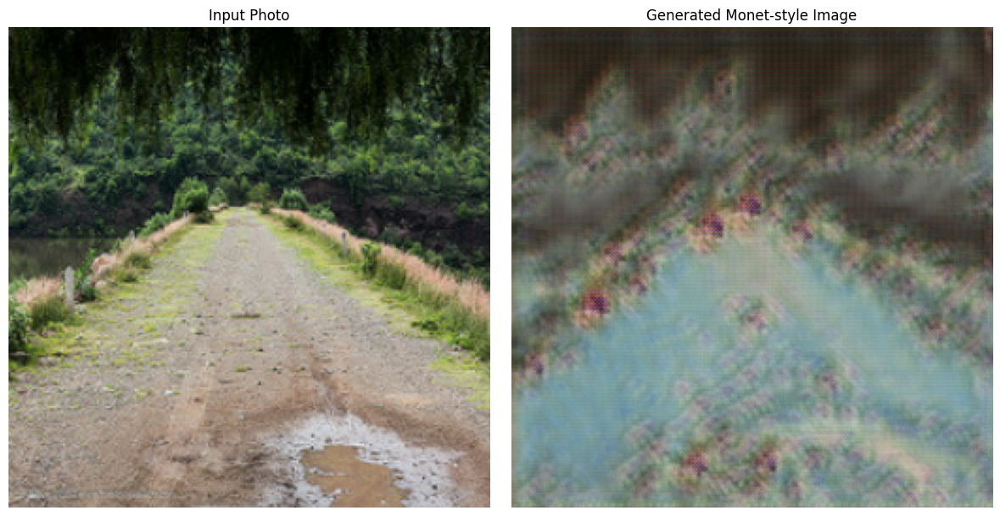

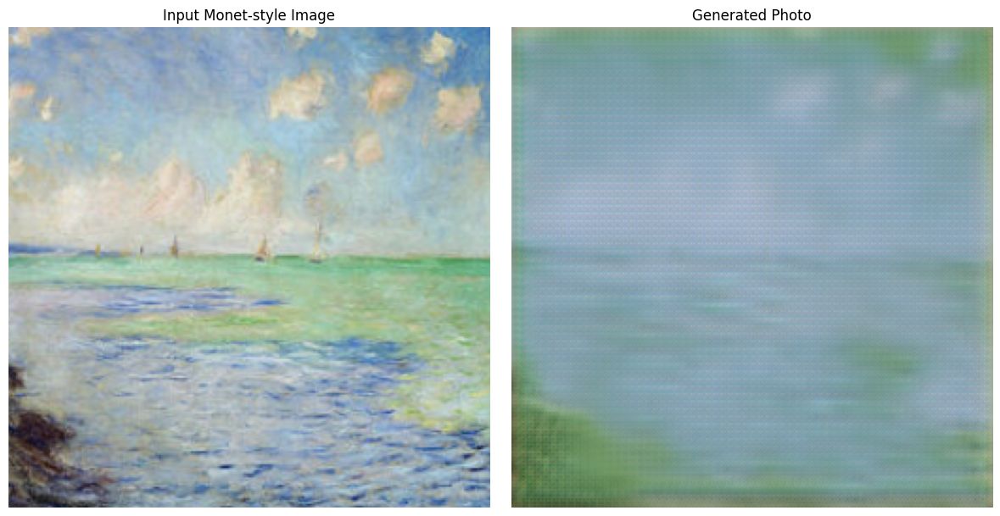

--------------------------------------
Time taken for epoch 7: 488.22 sec
Generator G loss: 10.7196
Generator F loss: 10.6233
Discriminator X loss: 0.5685
Discriminator Y loss: 0.5977
--------------------------------------
Epoch 8/10, Step 0/300
  gen_g_loss: 8.2867
  gen_f_loss: 8.5953
  disc_x_loss: 0.5474
  disc_y_loss: 0.8783
Epoch 8/10, Step 50/300
  gen_g_loss: 6.4026
  gen_f_loss: 6.9393
  disc_x_loss: 0.7271
  disc_y_loss: 0.5546
Epoch 8/10, Step 100/300
  gen_g_loss: 10.0504
  gen_f_loss: 9.4137
  disc_x_loss: 0.8795
  disc_y_loss: 0.7272
Epoch 8/10, Step 150/300
  gen_g_loss: 12.4829
  gen_f_loss: 11.8600
  disc_x_loss: 0.6268
  disc_y_loss: 0.7021
Epoch 8/10, Step 200/300
  gen_g_loss: 9.8041
  gen_f_loss: 10.9564
  disc_x_loss: 0.6751
  disc_y_loss: 0.7177
Epoch 8/10, Step 250/300
  gen_g_loss: 11.8216
  gen_f_loss: 11.4703
  disc_x_loss: 0.5975
  disc_y_loss: 0.8341


2025-05-20 15:33:15.772663: W tensorflow/core/kernels/data/cache_dataset_ops.cc:858] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


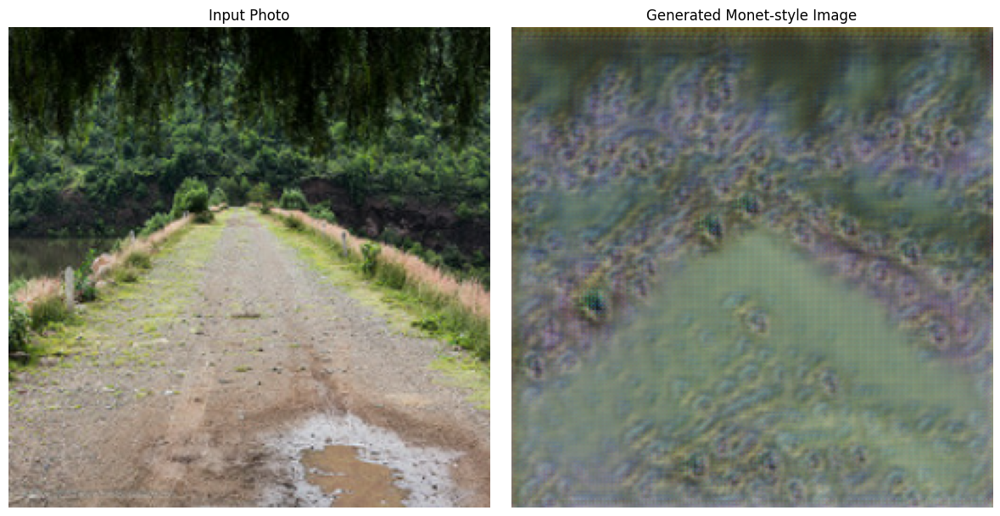

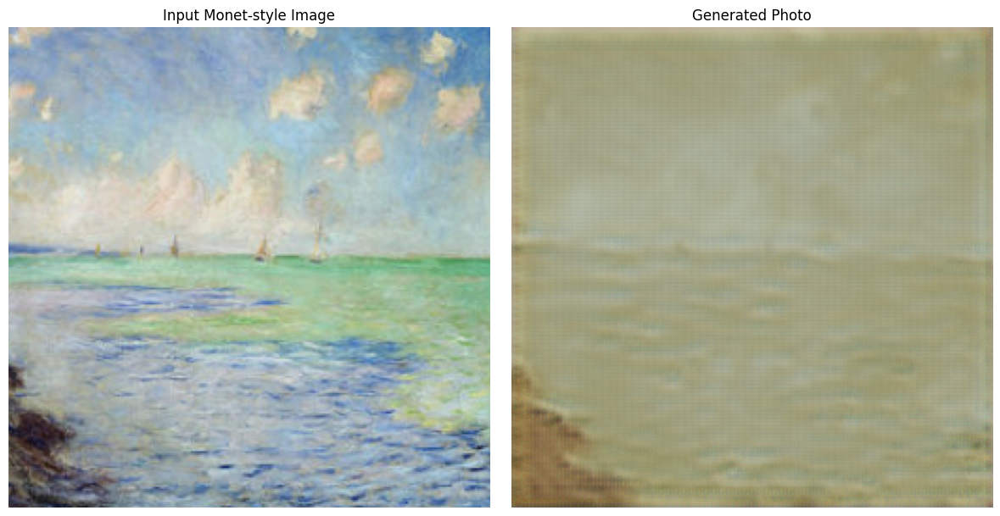

--------------------------------------
Time taken for epoch 8: 484.30 sec
Generator G loss: 10.5520
Generator F loss: 10.5410
Discriminator X loss: 0.5777
Discriminator Y loss: 0.6010
--------------------------------------
Epoch 9/10, Step 0/300
  gen_g_loss: 8.8602
  gen_f_loss: 9.1212
  disc_x_loss: 0.4748
  disc_y_loss: 0.4807
Epoch 9/10, Step 50/300
  gen_g_loss: 8.2749
  gen_f_loss: 7.7273
  disc_x_loss: 0.5978
  disc_y_loss: 0.6393
Epoch 9/10, Step 100/300
  gen_g_loss: 8.8225
  gen_f_loss: 8.7166
  disc_x_loss: 0.6417
  disc_y_loss: 0.4606
Epoch 9/10, Step 150/300
  gen_g_loss: 11.3457
  gen_f_loss: 11.7290
  disc_x_loss: 0.4019
  disc_y_loss: 1.0534
Epoch 9/10, Step 200/300
  gen_g_loss: 10.0184
  gen_f_loss: 9.9314
  disc_x_loss: 0.5322
  disc_y_loss: 0.7579
Epoch 9/10, Step 250/300
  gen_g_loss: 8.9636
  gen_f_loss: 8.6674
  disc_x_loss: 0.4792
  disc_y_loss: 0.5717


2025-05-20 15:41:21.198727: W tensorflow/core/kernels/data/cache_dataset_ops.cc:858] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


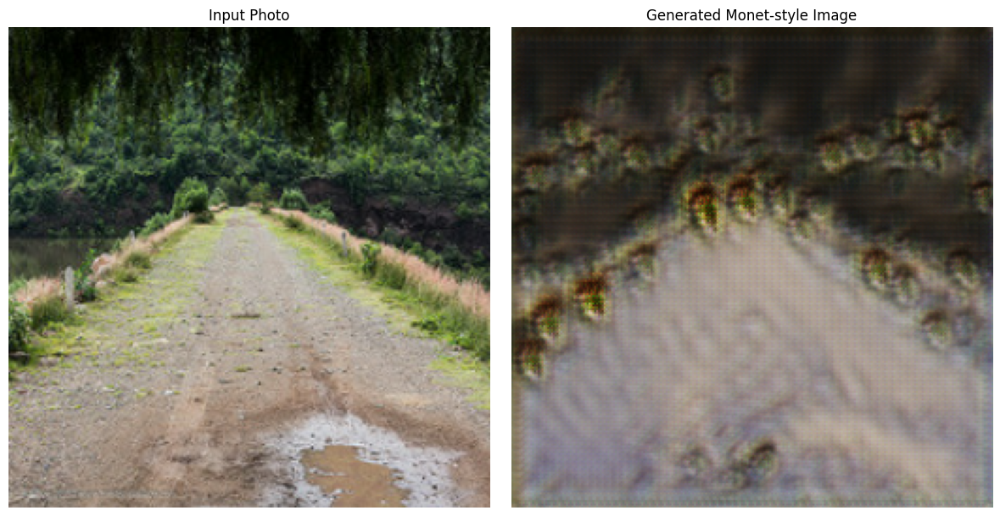

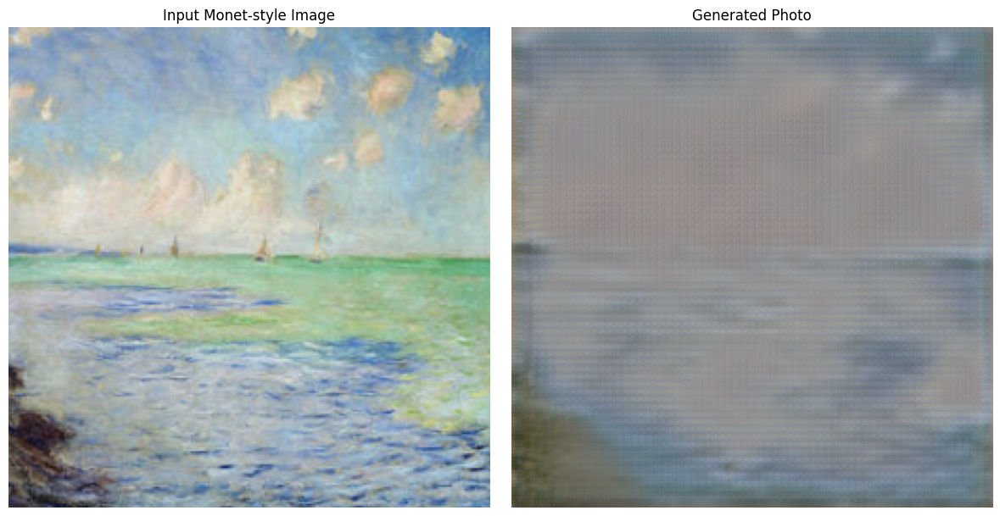

--------------------------------------
Time taken for epoch 9: 485.42 sec
Generator G loss: 10.3432
Generator F loss: 10.1654
Discriminator X loss: 0.5773
Discriminator Y loss: 0.6122
--------------------------------------
Epoch 10/10, Step 0/300
  gen_g_loss: 14.0333
  gen_f_loss: 15.0227
  disc_x_loss: 0.3669
  disc_y_loss: 0.2614
Epoch 10/10, Step 50/300
  gen_g_loss: 8.4047
  gen_f_loss: 8.8707
  disc_x_loss: 0.5731
  disc_y_loss: 0.6768
Epoch 10/10, Step 100/300
  gen_g_loss: 11.0490
  gen_f_loss: 10.2724
  disc_x_loss: 0.5006
  disc_y_loss: 0.8736
Epoch 10/10, Step 150/300
  gen_g_loss: 11.4404
  gen_f_loss: 11.0250
  disc_x_loss: 0.6839
  disc_y_loss: 0.6757
Epoch 10/10, Step 200/300
  gen_g_loss: 9.3088
  gen_f_loss: 9.5069
  disc_x_loss: 0.7006
  disc_y_loss: 0.4904
Epoch 10/10, Step 250/300
  gen_g_loss: 9.3685
  gen_f_loss: 9.9076
  disc_x_loss: 0.4224
  disc_y_loss: 0.2632


2025-05-20 15:49:25.413500: W tensorflow/core/kernels/data/cache_dataset_ops.cc:858] The calling iterator did not fully read the dataset being cached. In order to avoid unexpected truncation of the dataset, the partially cached contents of the dataset  will be discarded. This can happen if you have an input pipeline similar to `dataset.cache().take(k).repeat()`. You should use `dataset.take(k).cache().repeat()` instead.


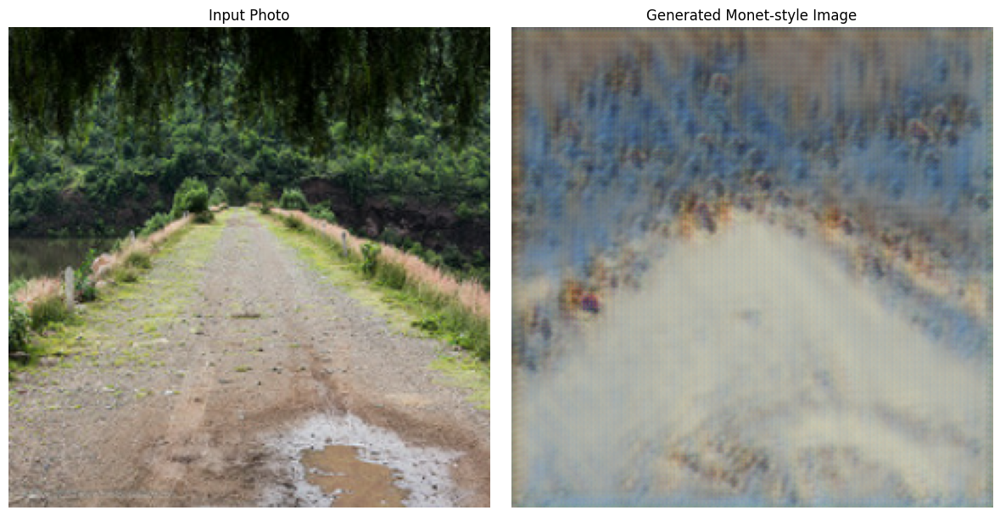

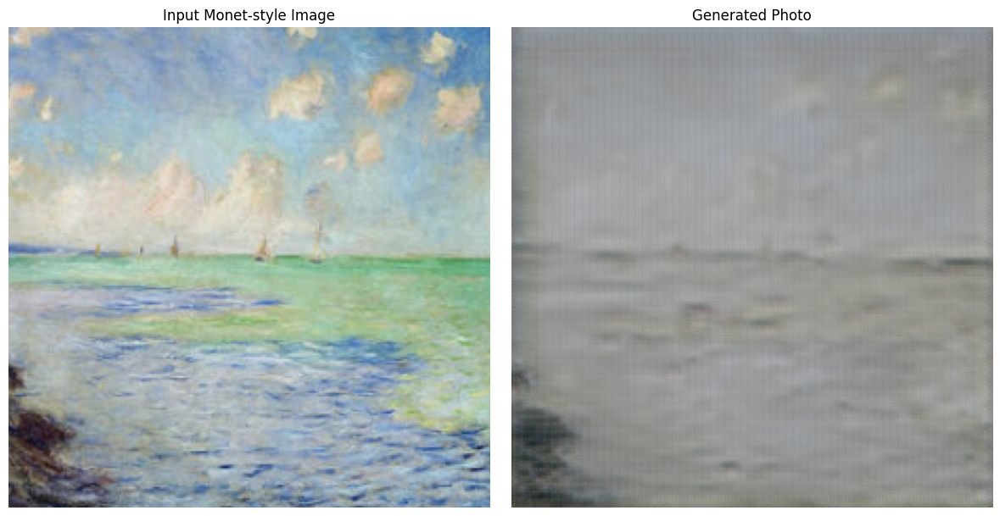

--------------------------------------
Time taken for epoch 10: 484.79 sec
Generator G loss: 10.5525
Generator F loss: 10.3694
Discriminator X loss: 0.5288
Discriminator Y loss: 0.6012
--------------------------------------


'ckpt-3'

In [19]:
# Run the training
epochs = 10
print("Starting training...")
# Sample test inputs for visualization during training
sample_monet = next(iter(monet_ds))
sample_photo = next(iter(photo_ds))

history = {
        'gen_g_loss': [],
        'gen_f_loss': [],
        'disc_x_loss': [],
        'disc_y_loss': []
    }
    

# Calculate the number of steps per epoch
steps_per_epoch = min(len(monet_jpg_files), len(photo_jpg_files)) // BATCH_SIZE

# Start training
for epoch in range(epochs):
    start = time.time()
    
    # Initialize metrics for this epoch
    epoch_metrics = {
        'gen_g_loss': [],
        'gen_f_loss': [],
        'disc_x_loss': [],
        'disc_y_loss': []
    }
    
    # Training loop
    for step, (x, y) in enumerate(zip(monet_ds, photo_ds)):
        if step >= steps_per_epoch:
            break
            
        metrics = train_step(x, y)
        
        # Track metrics
        for k, v in metrics.items():
            epoch_metrics[k].append(float(v))
            
        # Print progress
        if step % 50 == 0:
            print(f"Epoch {epoch+1}/{epochs}, Step {step}/{steps_per_epoch}")
            for k, v in metrics.items():
                print(f"  {k}: {v:.4f}")
    
    # Calculate average metrics for the epoch
    avg_metrics = {k: np.mean(v) for k, v in epoch_metrics.items()}
    
    # Generate sample images
    generate_images(generator_g, sample_photo, typ=1)
    generate_images(generator_f, sample_monet, typ=2)
    
    # Save checkpoint
    if (epoch + 1) % 5 == 0:
        checkpoint.save(file_prefix=checkpoint_prefix)

    print("--------------------------------------")
    print(f"Time taken for epoch {epoch+1}: {time.time()-start:.2f} sec")
    print(f"Generator G loss: {avg_metrics['gen_g_loss']:.4f}")
    history['gen_g_loss'].append(avg_metrics['gen_g_loss'])
    print(f"Generator F loss: {avg_metrics['gen_f_loss']:.4f}")
    history['gen_f_loss'].append(avg_metrics['gen_f_loss'])
    print(f"Discriminator X loss: {avg_metrics['disc_x_loss']:.4f}")
    history['disc_x_loss'].append(avg_metrics['disc_x_loss'])
    print(f"Discriminator Y loss: {avg_metrics['disc_y_loss']:.4f}")
    history['disc_y_loss'].append(avg_metrics['disc_y_loss'])
    print("--------------------------------------")

# Save the final model
checkpoint.save(file_prefix=checkpoint_prefix)

## Visualize Training History

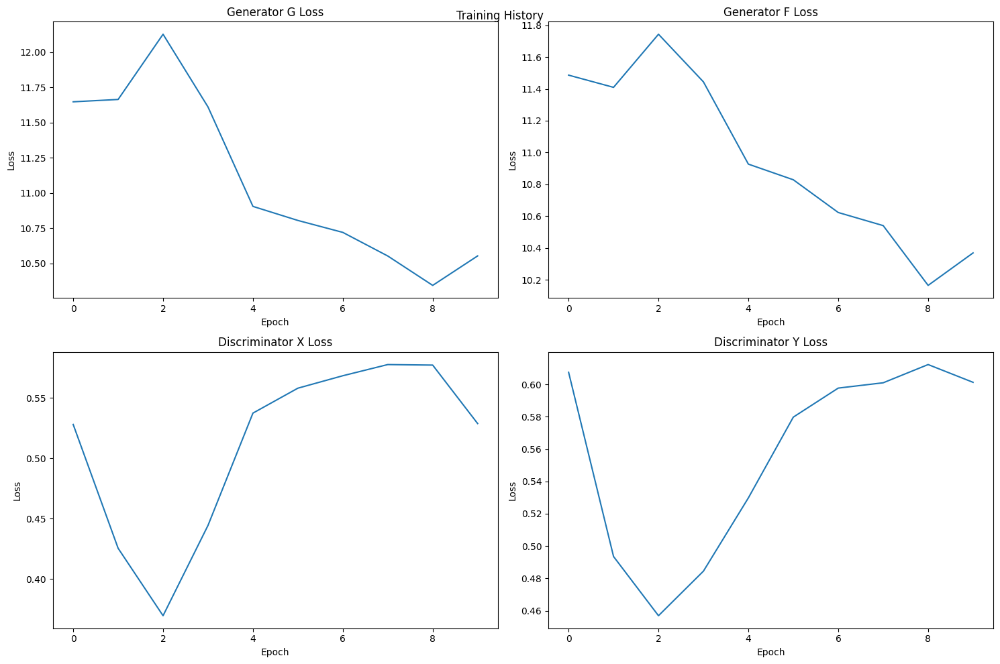

In [20]:
#Plot training history
fig, axes = plt.subplots(2, 2, figsize=(15, 10))

# Plot generator G loss
axes[0, 0].plot(history['gen_g_loss'])
axes[0, 0].set_title('Generator G Loss')
axes[0, 0].set_xlabel('Epoch')
axes[0, 0].set_ylabel('Loss')

# Plot generator F loss
axes[0, 1].plot(history['gen_f_loss'])
axes[0, 1].set_title('Generator F Loss')
axes[0, 1].set_xlabel('Epoch')
axes[0, 1].set_ylabel('Loss')

# Plot discriminator X loss
axes[1, 0].plot(history['disc_x_loss'])
axes[1, 0].set_title('Discriminator X Loss')
axes[1, 0].set_xlabel('Epoch')
axes[1, 0].set_ylabel('Loss')

# Plot discriminator Y loss
axes[1, 1].plot(history['disc_y_loss'])
axes[1, 1].set_title('Discriminator Y Loss')
axes[1, 1].set_xlabel('Epoch')
axes[1, 1].set_ylabel('Loss')

plt.tight_layout()
plt.suptitle(f"Training History")
plt.show()

## Model Evaluation

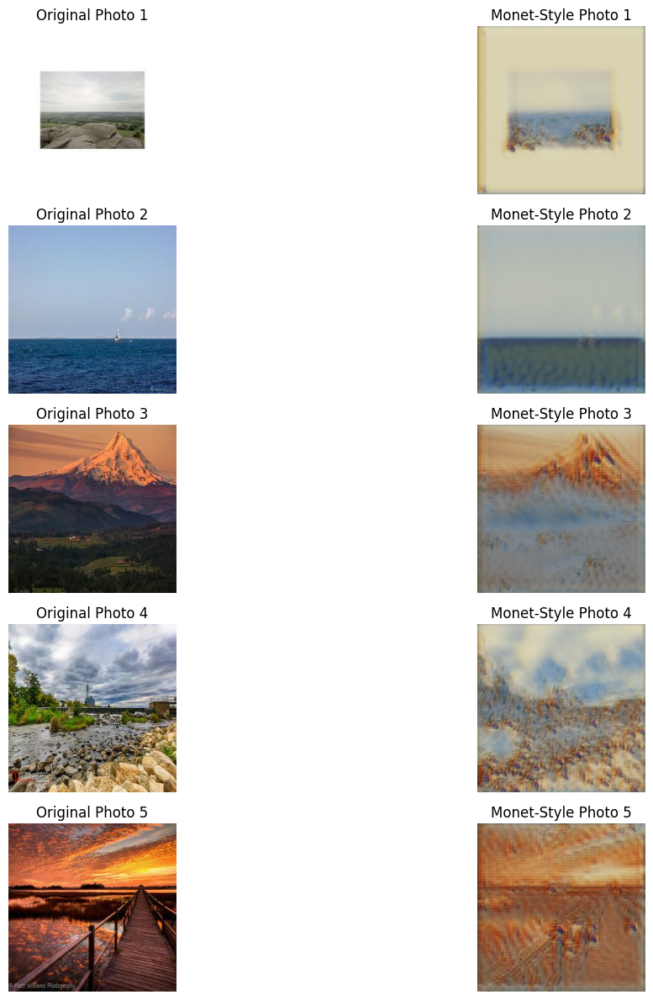

In [21]:
# Load test photos for evaluation
def load_test_photos(photo_path, num_samples=5):
    all_photos = glob(os.path.join(photo_path, '*.jpg'))
    selected_photos = np.random.choice(all_photos, num_samples, replace=False)
    
    test_photos = []
    for path in selected_photos:
        img = load_img(path, target_size=(IMAGE_SIZE[0], IMAGE_SIZE[1]))
        img = img_to_array(img)
        img = (img / 127.5) - 1  # Normalize to [-1, 1]
        test_photos.append(img)
    
    return np.array(test_photos)


checkpoint.restore(tf.train.latest_checkpoint('.'))

num_samples=5
# Generate some test images
test_photos = load_test_photos(PHOTO_JPG_PATH, num_samples=num_samples)

plt.figure(figsize=(15, 12))
for i, photo in enumerate(test_photos):
    # Generate Monet-style image
    monet_style = generator_g(photo[np.newaxis, ...])
    
    # Display original and stylized images
    plt.subplot(num_samples, 2, 2*i+1)
    plt.title(f"Original Photo {i+1}")
    plt.imshow((photo + 1) / 2)  # Convert from [-1, 1] to [0, 1]
    plt.axis('off')
    
    plt.subplot(num_samples, 2, 2*i+2)
    plt.title(f"Monet-Style Photo {i+1}")
    plt.imshow((monet_style[0] + 1) / 2)  # Convert from [-1, 1] to [0, 1]
    plt.axis('off')

plt.tight_layout()
plt.show()

## Generate Submission File

In [22]:
output_dir = 'generated_images'
output_zip = 'monet_submission.zip'
os.makedirs(output_dir, exist_ok=True)

# Get all test photos
test_photos = glob(os.path.join(PHOTO_JPG_PATH, '*.jpg')) 
print(f"Generating Monet-style images for {len(test_photos)} photos...")

# Process each photo
for i, photo_path in enumerate(test_photos):
    # Extract filename from the current photo_path
    base_filename = os.path.basename(photo_path)

    # Load and preprocess the image
    img = load_img(photo_path, target_size=(IMAGE_SIZE[0], IMAGE_SIZE[1]))
    img = img_to_array(img)
    img = (img / 127.5) - 1.0  # Normalize to [-1, 1]

    # Generate Monet-style image (ensure img has batch dimension)
    generated_img_tensor = generator_g(img[np.newaxis, ...], training=False) # Add training=False if applicable

    # Convert back to [0, 255] range and uint8
    generated_img_np = ((generated_img_tensor[0] + 1.0) * 127.5).numpy().astype(np.uint8)

    # Save the generated image
    output_path = os.path.join(output_dir, base_filename)
    tf.keras.preprocessing.image.save_img(output_path, generated_img_np)

    # Print progress occasionally
    if (i + 1) % 1000 == 0:
        print(f"Processed {i+1}/{len(test_photos)} images")

print(f"Finished generating images.")

# Create ZIP file for submission
with zipfile.ZipFile(output_zip, 'w') as zipf:
    for file_in_dir in os.listdir(output_dir):
        zipf.write(os.path.join(output_dir, file_in_dir), file_in_dir)

print(f"Submission file created: {output_zip}")

Generating Monet-style images for 7038 photos...
Processed 1000/7038 images
Processed 2000/7038 images
Processed 3000/7038 images
Processed 4000/7038 images
Processed 5000/7038 images
Processed 6000/7038 images
Processed 7000/7038 images
Finished generating images.
Submission file created: monet_submission.zip


## Conclusion and Discussion


In this notebook, I have implemented a CycleGAN to transform ordinary photos into Monet style paintings.


1. **Data Exploration and Preparation:**
   - I have explored the dataset of Monet paintings and regular photographs.
   - I have analyzed image dimensions and color distributions to understand the differences between the domains.
   - I have built an efficient data pipeline with augmentation to improve model generalization.

2. **Model Architecture:**
   - I have implemented a CycleGAN with two generators and two discriminators.
   - The generators used a ResNet-based architecture with residual blocks for effective style transfer.
   - The discriminators used a PatchGAN architecture to classify local patches as real or fake.

3. **Training Process:**
   - I have trained the model using adversarial, cycle consistency, and identity losses.
   - The adversarial loss helped generate realistic images in each domain.
   - The cycle consistency loss ensured that the content of the original image was preserved.
   - The identity loss helped preserve color composition.

4. **Results:**
   - I have generated Monet-style images from regular photographs.
   - I have evaluated the model by visually comparing original photos and their stylized versions.

## Discussion:

### Strengths:

1. **Unpaired Training:** CycleGAN allowed to train without paired data, which is crucial as it doesn't have "before-after" pairs of the same scene.

2. **Content Preservation:** The cycle consistency loss helped preserve the content and structure of the original photos while transferring Monet's style.

3. **Bidirectional Mapping:** Although my main goal was Photo → Monet transformation, the model also learned the reverse mapping (Monet → Photo).


## Final Thoughts:

The CycleGAN approach has successfully generated images that capture many aspects of Monet's style, including his brushwork, color palette, and light treatment. While the results are impressive, there's always room for improvement.

This project demonstrates the power of deep learning in creative applications and bridges the gap between technology and art, allowing us to explore new ways of understanding and appreciating artistic styles.
